In [151]:
# import os
# os.environ["XLA_FLAGS"] = "--xla_gpu_strict_conv_algorithm_picker=false"

# import jax
import jax
jax.config.update('jax_platform_name', 'cpu')
# print("jax version:", jax.__version__)
# print("jax devices:", jax.devices())
import jax.numpy as jnp
import numpy as np
import functools
import abc
import torch
import torch.nn as nn

from IPython.display import HTML
import matplotlib.animation as anim
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import matplotlib as mpl
import matplotlib.colors as mcolors
import matplotlib.collections as mcoll
import time
import pypalettes
from matplotlib.lines import Line2D
import matplotlib.patches as patches
from scipy.interpolate import CubicSpline

import hj_reachability as hj
from hj_reachability.finite_differences import upwind_first

from hjnnv import hjnnvUncertaintyAwareFilter
from dynamic_models.beacon import BeaconDynamics
from simulators.beacon_env.desired_trajectories import DesiredTrajectory


# jax.config.update("jax_cudnn_use_autotuned", False)
import warnings
warnings.filterwarnings("ignore", category=ResourceWarning)

In [2]:
import matplotlib.colors as mcolors

rgb_colors = np.array(pypalettes.load_cmap("Alexandrite").rgb)/255.0
rgb_colors[2] = rgb_colors[2] * 0.8
black = list(rgb_colors[0])
pink = list(rgb_colors[1])
dark_teal = list(rgb_colors[2])
light_teal = list(rgb_colors[3])
purple = list(rgb_colors[4])
orange = list(rgb_colors[5])
yellow = [240/255.0, 225/255.0, 0/255.0]  # yellow
dark_orange = [255/255.0, 103/255.0, 0/255.0]
# gray = [70/255.0, 45/255.0, 255/255.0]  # red
# gray = dark_orange
light_purple = list(rgb_colors[6])
teal = list(rgb_colors[7])
hot_pink = [1.0, 46/255.0, 204/255.0]  # hot pink

plt.rcParams['font.family'] = 'serif'          # e.g., 'sans-serif', 'serif', 'monospace'
plt.rcParams['font.serif'] = ['Times New Roman']  # specify font
plt.rcParams['font.size'] = 20                 # set global font size
mpl.rcParams["text.usetex"] = True

In [10]:
epsilon = 0.1
smoothing = True
smoothing_alpha = 0.9
dt = 0.1
max_input = 5.0
# max_position_disturbance = 0.1
# max_vel_disturbance = 0.01
max_position_disturbance = 1e-2
max_vel_disturbance = 1e-1
seed = 1
# model_name="simple_estimator_3t_long_range"
# model_name="simple_estimator_3t"
model_name="square_landmark_estimator"
# model_name="diagonal_landmark_estimator"

dynamics = BeaconDynamics(
    dt=dt,
    max_input=max_input,
    max_position_disturbance=max_position_disturbance,
    max_vel_disturbance=max_vel_disturbance,
    range_disturbance=epsilon,
    model_name=model_name,
    random_seed=seed
)
grid = hj.Grid.from_lattice_parameters_and_boundary_conditions(
            hj.sets.Box(
                np.array([-5., -5., -5., -5.]),
                np.array([15., 15., 5., 5.])),
            (30, 30, 20, 20),
        )
values_ = jnp.stack([jnp.abs(grid.states[..., 0] - 5.), jnp.abs(grid.states[..., 1] - 5.)], axis=-1)
values = -jnp.max(values_, axis=-1) + 5.

solver_settings = hj.SolverSettings.with_accuracy("very_high",
                                                  hamiltonian_postprocessor=hj.solver.backwards_reachable_tube)
cmap = 'viridis'

if smoothing:
    estimation_function = functools.partial(dynamics.get_smoothed_state_distance_estimate, alpha=smoothing_alpha)
else:
    estimation_function = dynamics.get_state_estimate

hjnnv_filter = hjnnvUncertaintyAwareFilter(
    dynamics=dynamics,
    pred_model=estimation_function,
    grid=grid,
    initial_values=values,
    num_controls=30,
    num_disturbances=2
)

100%|##########| 10.0000/10.0 [00:44<00:00,  4.44s/sim_s]


In [4]:


# Parameters
traj_type = "spiral"  # "lawnmower" or "spiral"

if traj_type == "lawnmower":
    square_size = 9
    lane_width = 1.0
    num_lanes = int(square_size / lane_width) + 1
    points_per_lane = 50
    T_lane = 15.0  # seconds per lane

    waypoints_x = []
    waypoints_y = []
    time_stamps = []

    t = 0.0
    for i in range(num_lanes):
        y = i * lane_width
        if i % 2 == 0:
            x_start, x_end = 0, square_size
        else:
            x_start, x_end = square_size, 0
        
        # Only append the start of the lane if this is the first lane or first point
        if i == 0:
            waypoints_x.append(x_start)
            waypoints_y.append(y)
            time_stamps.append(t)
        
        # Append end of the lane
        t += T_lane
        waypoints_x.append(x_end)
        waypoints_y.append(y)
        time_stamps.append(t)

        if i == num_lanes - 1:
            waypoints_x.append(x_start)
            waypoints_y.append(y)
            time_stamps.append(t + T_lane)

    waypoints_x = np.array(waypoints_x)
    waypoints_y = np.array(waypoints_y)
    time_stamps = np.array(time_stamps)

    # Cubic splines with zero velocities at start and end
    spline_x = CubicSpline(time_stamps, waypoints_x + 0.5, bc_type=((1,0.0),(1,0.0)))
    spline_y = CubicSpline(time_stamps, waypoints_y + 0.5, bc_type=((1,0.0),(1,0.0)))

    t_samples = np.linspace(0, time_stamps[-1], num_lanes * points_per_lane)
    x_traj = spline_x(t_samples)
    y_traj = spline_y(t_samples)
    vx_traj = spline_x(t_samples, 1)
    vy_traj = spline_y(t_samples, 1)
    ax_traj = spline_x(t_samples, 2)
    ay_traj = spline_y(t_samples, 2)
    
elif traj_type == "spiral":
    # geometry + speed params
    center = 5.0
    radius = 5.0
    v_max = 1.0
    circle_start_angle = np.pi/6  # change as you like

    cx = cy = center
    theta = circle_start_angle
    s = np.sin(theta)

    # fillet geometry (tangent to horizontal line y=cy and big circle)
    r_f = radius * s / (1.0 + s + 1e-12)
    Cf_x = cx + (radius - r_f) * np.cos(theta)
    Cf_y = cy + (radius - r_f) * np.sin(theta)

    # join point between horizontal line and the fillet
    Sx, Sy = Cf_x, cy

    # containers
    waypoints_x = []
    waypoints_y = []
    time_stamps = []
    s_total = 0.0

    # --- smooth accel profile: constant acceleration up to s_accel then cruise ---
    s_accel = radius * 0.5              # distance over which we accelerate
    a = 0.5 * v_max**2 / (s_accel + 1e-12)
    t_accel = v_max / a

    def time_from_s(s_local):
        if s_local <= 0.0:
            return 0.0
        if s_local < s_accel:
            return np.sqrt(2.0 * s_local / a)
        else:
            return t_accel + (s_local - s_accel) / v_max

    def append_path_points(xs, ys):
        nonlocal_vars = {}
        global s_total
        for (x, y) in zip(xs, ys):
            if not waypoints_x:
                waypoints_x.append(x)
                waypoints_y.append(y)
                time_stamps.append(0.0)
                continue
            dx = x - waypoints_x[-1]
            dy = y - waypoints_y[-1]
            ds = np.hypot(dx, dy)
            s_prev = s_total
            s_total += ds
            t_new = time_from_s(s_total)
            waypoints_x.append(x)
            waypoints_y.append(y)
            time_stamps.append(t_new)

    # --- Step 1: line from center to S ---
    num_line_points = 40
    if Sx > cx + 1e-12:
        xs = np.linspace(cx, Sx, num_line_points)
        ys = np.full_like(xs, cy)
    else:
        xs = np.array([Sx])
        ys = np.array([Sy])
    append_path_points(xs, ys)

    # --- Step 2: fillet arc ---
    num_arc_points = 80
    phis = np.linspace(-np.pi/2, theta, num_arc_points + 1)[1:]
    xs = Cf_x + r_f * np.cos(phis)
    ys = Cf_y + r_f * np.sin(phis)
    append_path_points(xs, ys)

    # --- Step 3: big circle ---
    num_circle_points = 200
    thetas = np.linspace(theta, theta + 2*np.pi, num_circle_points + 1)[1:]
    xs = cx + radius * np.cos(thetas)
    ys = cy + radius * np.sin(thetas)
    append_path_points(xs, ys)

    # convert to numpy arrays
    waypoints_x = np.array(waypoints_x)
    waypoints_y = np.array(waypoints_y)
    time_stamps = np.array(time_stamps)

    # --- spline ---
    spline_x = CubicSpline(time_stamps, waypoints_x, bc_type="clamped")
    spline_y = CubicSpline(time_stamps, waypoints_y, bc_type="clamped")

    t_samples = np.linspace(0.0, time_stamps[-1], 500)
    x_traj = spline_x(t_samples)
    y_traj = spline_y(t_samples)
    vx_traj = spline_x(t_samples, 1)
    vy_traj = spline_y(t_samples, 1)
    ax_traj = spline_x(t_samples, 2)
    ay_traj = spline_y(t_samples, 2)
    # center = 5.0
    # radius = 5.0
    # vel = 1.0
    # circle_start_angle = np.pi/6  # e.g., π/6; works up to near π (see note)

    # cx = cy = center
    # theta = circle_start_angle
    # s = np.sin(theta)

    # # Fillet radius (tangent to line y=c and the big circle of radius R)
    # # Add tiny eps to avoid division by zero when theta ~ 0
    # r_f = radius * s / (1.0 + s + 1e-12)

    # # Fillet center
    # Cf_x = cx + (radius - r_f) * np.cos(theta)
    # Cf_y = cy + (radius - r_f) * np.sin(theta)

    # # Start of fillet (tangent to the horizontal line y=cy)
    # Sx, Sy = Cf_x, cy

    # waypoints_x, waypoints_y, time_stamps = [], [], []
    # t = 0.0

    # # --- Straight line from center -> S ---
    # num_line_points = 40
    # if Sx > cx + 1e-12:  # positive-length line; if zero, we just skip
    #     xs = np.linspace(cx, Sx, num_line_points)
    #     ys = np.full_like(xs, cy)
    #     for i in range(len(xs)):
    #         line_vel = i/len(xs) * vel
    #         waypoints_x.append(xs[i])
    #         waypoints_y.append(ys[i])
    #         if i > 0:
    #             dx = xs[i] - xs[i-1]
    #             dy = ys[i] - ys[i-1]
    #             t += np.hypot(dx, dy) / line_vel
    #         time_stamps.append(t)
    # else:
    #     # Start directly at S if the straight segment collapses (e.g., theta=π/2)
    #     waypoints_x.append(Sx); waypoints_y.append(Sy); time_stamps.append(t)

    # # --- Fillet arc from φ=-π/2 (at S) to φ=theta (merge point on big circle) ---
    # num_arc_points = 80
    # phis = np.linspace(-np.pi/2, theta, num_arc_points+1)[1:]  # skip duplicate S
    # for φ in phis:
    #     x = Cf_x + r_f * np.cos(φ)
    #     y = Cf_y + r_f * np.sin(φ)
    #     dx = x - waypoints_x[-1]
    #     dy = y - waypoints_y[-1]
    #     t += np.hypot(dx, dy) / vel
    #     waypoints_x.append(x); waypoints_y.append(y); time_stamps.append(t)

    # # --- Big circle from theta onward (one lap) ---
    # num_circle_points = 200
    # thetas = np.linspace(theta, theta + 2*np.pi, num_circle_points+1)[1:]
    # for th in thetas:
    #     x = cx + radius * np.cos(th)
    #     y = cy + radius * np.sin(th)
    #     dx = x - waypoints_x[-1]
    #     dy = y - waypoints_y[-1]
    #     t += np.hypot(dx, dy) / vel
    #     waypoints_x.append(x); waypoints_y.append(y); time_stamps.append(t)

    # waypoints_x = np.array(waypoints_x)
    # waypoints_y = np.array(waypoints_y)
    # time_stamps = np.array(time_stamps)

    # # Spline the time-parameterized path (keep endpoints clamped if you want zero start/end vel)
    # spline_x = CubicSpline(time_stamps, waypoints_x, bc_type="clamped")
    # spline_y = CubicSpline(time_stamps, waypoints_y, bc_type="clamped")

    # t_samples = np.linspace(0, time_stamps[-1], 500)
    # x_traj = spline_x(t_samples)
    # y_traj = spline_y(t_samples)
    # vx_traj = spline_x(t_samples, 1)
    # vy_traj = spline_y(t_samples, 1)
    # ax_traj = spline_x(t_samples, 2)
    # ay_traj = spline_y(t_samples, 2)

elif traj_type == "circle":
    # Circle trajectory
    center = 5.0
    radius = 5.0
    vel = 1.0
    
    def circle_trajectory(t, deriv=0):
        omega = vel / radius
        if deriv == 0:
            x = center + radius * np.cos(omega * t)
            y = center + radius * np.sin(omega * t)
        elif deriv == 1:
            x = -radius * omega * np.sin(omega * t)
            y = radius * omega * np.cos(omega * t)
        elif deriv == 2:
            x = -radius * omega**2 * np.cos(omega * t)
            y = -radius * omega**2 * np.sin(omega * t)
        return x, y

    def spline_x(t, deriv=0):
        x, _ = circle_trajectory(t, deriv)
        return x

    def spline_y(t, deriv=0):
        _, y = circle_trajectory(t, deriv)
        return y
    



In [5]:
def rov_controller(state, desired_traj, time, kp=3.0, kd=0.5):
    spline_x, spline_y = desired_traj.generate_trajectory()
    ax_des = spline_x(time, 2)
    ay_des = spline_y(time, 2)
    vx_des = spline_x(time, 1)
    vy_des = spline_y(time, 1)
    x_des = spline_x(time)
    y_des = spline_y(time)

    # kp = 3.0  # Control gain
    # kd = 1.0*0.5  # Derivative gain

    ux = ax_des + kp * (x_des - state[0]) + kd * (vx_des - state[2])
    uy = ay_des + kp * (y_des - state[1]) + kd * (vy_des - state[3])

    u = jnp.array([ux, uy])
    u_clipped = jnp.clip(u, -1.0, 1.0)
    return u_clipped

In [6]:
def fgsm(model, target, observation, epsilon=0.1, loss_fn=lambda x, y: jnp.mean((x - y) ** 2)):
    # observation must have requires_grad equivalent: use jax.grad w.r.t. observation
    grad_fn = jax.grad(lambda obs: loss_fn(model(obs), target))
    grad = grad_fn(observation)
    # print("grad", grad)
    perturbation = - epsilon * jnp.sign(grad)
    adv_observation = observation + perturbation
    # adv_observation = jnp.clip(adv_observation, 0.0, 1.0)
    return adv_observation

@functools.partial(jax.jit, static_argnames=['model', 'loss_fn', 'iters', 'alpha', 'epsilon'])
def pgd(model, target, observation, epsilon=0.1, alpha=0.01, iters=40, loss_fn=lambda x,y: jnp.mean((x-y)**2)):
    adv = observation.copy()
    for _ in range(iters):
        grad = jax.grad(lambda o: loss_fn(model(o), target))(adv)
        adv = adv - alpha * jnp.sign(grad)   # take a small FGSM step
    adv = jnp.clip(adv, observation - epsilon, observation + epsilon)  # project into ε-ball
    # if inputs must be valid (e.g. image in [0,1]):
    # adv = jnp.clip(adv, 0.0, 1.0)
    return adv

## FGSM Test

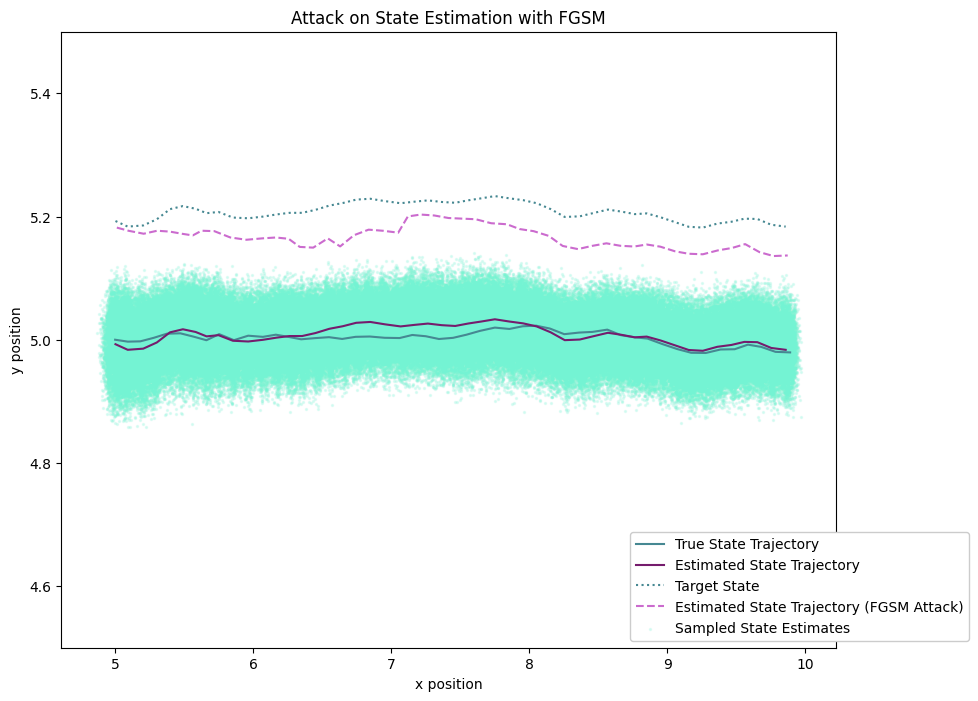

In [ ]:
model_name="simple_estimator_3t_long_range"
dynamics = BeaconDynamics(
    dt=dt,
    max_input=max_input,
    max_position_disturbance=max_position_disturbance,
    max_vel_disturbance=max_vel_disturbance,
    range_disturbance=0.0001,
    model_name=model_name,
    random_seed=seed
)

epsilon = 0.1
smoothing = False
num_steps = 50
num_samples = 5000
seed = 1
key = jax.random.PRNGKey(seed)

state_history = []
target_plus_history = []
target_minus_history = []
state_hat_history = []
state_hat_fgsm_history = []
state_hat_pgd_plus_history = []
state_hat_pgd_minus_history = []
state_samples_history = []

state = jnp.array([5., 5., 1., 0.])
state_hat = state
u = jnp.array([0., 0.])
for step in range(num_steps):
    key, subkey = jax.random.split(key)
    t = step * dynamics.dt
    # Simulate the system dynamics
    obs = dynamics.get_observation(state, time=step)
    if smoothing:
        est_obs = jnp.concatenate([state_hat, u, obs])  # append previous state estimate and input
        state_hat = dynamics.get_smoothed_state_distance_estimate(est_obs).flatten()

        beta = 0.4
        target_plus = state_hat + beta * jnp.array([0., 1., 0., 0.])
        target_minus = state_hat - beta * jnp.array([0., 1., 0., 0.])
        obs_fgsm = fgsm(model=dynamics.get_state_estimate, target=target_plus, observation=obs, epsilon=epsilon)
        obs_pgd_plus = pgd(model=dynamics.get_state_estimate, target=target_plus, observation=obs, epsilon=epsilon, alpha=0.01, iters=40)
        obs_pgd_minus = pgd(model=dynamics.get_state_estimate, target=target_minus, observation=obs, epsilon=epsilon, alpha=0.01, iters=40)

        state_hat_fgsm = dynamics.get_smoothed_state_distance_estimate(jnp.concatenate([state_hat, u, obs_fgsm])).flatten()
        state_hat_pgd_plus = dynamics.get_smoothed_state_distance_estimate(jnp.concatenate([state_hat, u, obs_pgd_plus])).flatten()
        state_hat_pgd_minus = dynamics.get_smoothed_state_distance_estimate(jnp.concatenate([state_hat, u, obs_pgd_minus])).flatten()
    else:
        state_hat = dynamics.get_state_estimate(obs).flatten()

        beta = 0.2
        target_plus = state_hat + beta * jnp.array([0., 1., 0., 0.])
        target_minus = state_hat - beta * jnp.array([0., 1., 0., 0.])
        obs_fgsm = fgsm(model=dynamics.get_state_estimate, target=target_plus, observation=obs, epsilon=epsilon)
        obs_pgd_plus = pgd(model=dynamics.get_state_estimate, target=target_plus, observation=obs, epsilon=epsilon, alpha=0.01, iters=40)
        obs_pgd_minus = pgd(model=dynamics.get_state_estimate, target=target_minus, observation=obs, epsilon=epsilon, alpha=0.01, iters=40)

        state_hat_fgsm = dynamics.get_state_estimate(obs_fgsm).flatten()
        state_hat_pgd_plus = dynamics.get_state_estimate(obs_pgd_plus).flatten()
        state_hat_pgd_minus = dynamics.get_state_estimate(obs_pgd_minus).flatten()
        # state_hat_pgd2 = dynamics.get_state_estimate(obs_pgd2).flatten()
    u_nominal = jnp.array([0., 0.])
    # sampling based approach to see what is feasible
    obs_perturbations = jax.random.uniform(
        subkey, shape=(num_samples, obs.shape[0]),
        minval=-epsilon, maxval=epsilon
    )
    obs_samples = obs + obs_perturbations
    state_samples_0 = jax.vmap(lambda o: dynamics.get_state_estimate(o).flatten())(obs_samples)
    state_history.append(state)
    target_plus_history.append(target_plus)
    target_minus_history.append(target_minus)
    state_hat_history.append(state_hat)
    state_hat_fgsm_history.append(state_hat_fgsm)
    state_hat_pgd_plus_history.append(state_hat_pgd_plus)
    state_hat_pgd_minus_history.append(state_hat_pgd_minus)
    state_samples_history.append(state_samples_0)
    state = dynamics.step(state, u, dynamics.get_random_disturbance(), time=step)

# rgb_colors = np.array(pypalettes.load_cmap("Color_Blind").rgb)/255.0
# darkblue = list(rgb_colors[0])
# orange = list(rgb_colors[1])
# med_grey = list(rgb_colors[2])
# dark_grey = list(rgb_colors[3])
# lightblue = list(rgb_colors[4])
# red = list(rgb_colors[5])
# darkmed_grey = list(rgb_colors[6])
# lightlightblue = list(rgb_colors[7])

rgb_colors = np.array(pypalettes.load_cmap("Alexandrite").rgb)/255.0
black = list(rgb_colors[0])
pink = list(rgb_colors[1])
dark_teal = list(rgb_colors[2])
light_teal = list(rgb_colors[3])
purple = list(rgb_colors[4])
orange = list(rgb_colors[5])
light_purple = list(rgb_colors[6])
teal = list(rgb_colors[7])

state_history = jnp.stack(state_history)
target_plus_history = jnp.stack(target_plus_history)
target_minus_history = jnp.stack(target_minus_history)
state_hat_history = jnp.stack(state_hat_history)
state_hat_fgsm_history = jnp.stack(state_hat_fgsm_history)
state_hat_pgd_plus_history = jnp.stack(state_hat_pgd_plus_history)
state_hat_pgd_minus_history = jnp.stack(state_hat_pgd_minus_history)
state_samples_history = jnp.stack(state_samples_history)

plt.figure(figsize=(10, 8))
plt.plot(state_history[:, 0], state_history[:, 1], label="True State Trajectory", c=dark_teal)
plt.plot(state_hat_history[:, 0], state_hat_history[:, 1], label="Estimated State Trajectory", c=purple)
plt.plot(target_plus_history[:, 0], target_plus_history[:, 1], label="Target State", c=dark_teal, linestyle='dotted')
# plt.plot(target_minus_history[:, 0], target_minus_history[:, 1], label="Target (Desired) State Negative", c=lightblue, linestyle='dotted')
plt.plot(state_hat_fgsm_history[:, 0], state_hat_fgsm_history[:, 1], label="Estimated State Trajectory (FGSM Attack)", c=pink, linestyle='dashed')
# plt.plot(state_hat_pgd_plus_history[:, 0], state_hat_pgd_plus_history[:, 1], label="Estimated State Trajectory (PGD Attack)", c='purple', linestyle='dashdot')
# plt.plot(state_hat_pgd_minus_history[:, 0], state_hat_pgd_minus_history[:, 1], label="Estimated State Trajectory (PGD Attack Negative)", c=darkblue, linestyle='dashdot')
plt.scatter(state_samples_history[:, :, 0], state_samples_history[:, :, 1], color=light_teal, s=2, alpha=0.2, label="Sampled State Estimates")
plt.xlabel("x position")
plt.ylabel("y position")
plt.title("Attack on State Estimation with FGSM")
plt.legend(loc="lower right", bbox_to_anchor=(1.18, 0.0), framealpha=1.0)
# plt.xlim(-1, 11)
plt.ylim(4.5, 5.5)
# plt.grid(True)
# plt.gca().set_aspect('equal')
plt.show()

In [9]:
model_name="image_estimator_16x128_2step-skip"
dynamics = BeaconDynamics(
    dt=dt,
    max_input=max_input,
    max_position_disturbance=max_position_disturbance,
    max_vel_disturbance=max_vel_disturbance,
    range_disturbance=0.000001,
    obs_type="images",
    model_name=model_name,
    random_seed=seed
)

epsilon = 0.005
smoothing = False
num_steps = 50
num_samples = 5000
seed = 1
key = jax.random.PRNGKey(seed)

state_history = []
target_plus_history = []
target_minus_history = []
state_hat_history = []
state_hat_fgsm_history = []
state_hat_pgd_plus_history = []
state_hat_pgd_minus_history = []
state_samples_history = []

state = jnp.array([5., 5., 1., 0.])
state_hat = state
u = jnp.array([0., 0.])
for step in range(num_steps):
    key, subkey = jax.random.split(key)
    t = step * dynamics.dt
    # Simulate the system dynamics
    obs = dynamics.get_observation(state, time=step)
    obs = obs.squeeze(axis=2)
    if smoothing:
        est_obs = jnp.concatenate([state_hat, u, obs])  # append previous state estimate and input
        state_hat = dynamics.get_smoothed_state_distance_estimate(est_obs).flatten()

        beta = 0.4
        target_plus = state_hat + beta * jnp.array([0., 1., 0., 0.])
        target_minus = state_hat - beta * jnp.array([0., 1., 0., 0.])
        obs_fgsm = fgsm(model=dynamics.get_state_estimate, target=target_plus, observation=obs, epsilon=epsilon)
        obs_pgd_plus = pgd(model=dynamics.get_state_estimate, target=target_plus, observation=obs, epsilon=epsilon, alpha=0.01, iters=40)
        # obs_pgd_minus = pgd(model=dynamics.get_state_estimate, target=target_minus, observation=obs, epsilon=epsilon, alpha=0.01, iters=40)

        state_hat_fgsm = dynamics.get_smoothed_state_distance_estimate(jnp.concatenate([state_hat, u, obs_fgsm])).flatten()
        state_hat_pgd_plus = dynamics.get_smoothed_state_distance_estimate(jnp.concatenate([state_hat, u, obs_pgd_plus])).flatten()
        # state_hat_pgd_minus = dynamics.get_smoothed_state_distance_estimate(jnp.concatenate([state_hat, u, obs_pgd_minus])).flatten()
    else:
        state_hat = dynamics.get_state_estimate(obs).flatten()

        beta = 0.5
        target_plus = state_hat + beta * jnp.array([0., 1., 0., 0.])
        target_minus = state_hat - beta * jnp.array([0., 1., 0., 0.])
        obs_fgsm = fgsm(model=dynamics.get_state_estimate, target=target_plus, observation=obs, epsilon=epsilon)
        obs_pgd_plus = pgd(model=dynamics.get_state_estimate, target=target_plus, observation=obs, epsilon=epsilon, alpha=0.01, iters=40)
        # obs_pgd_minus = pgd(model=dynamics.get_state_estimate, target=target_minus, observation=obs, epsilon=epsilon, alpha=0.01, iters=40)

        state_hat_fgsm = dynamics.get_state_estimate(obs_fgsm).flatten()
        state_hat_pgd_plus = dynamics.get_state_estimate(obs_pgd_plus).flatten()
        # state_hat_pgd_minus = dynamics.get_state_estimate(obs_pgd_minus).flatten()
        # state_hat_pgd2 = dynamics.get_state_estimate(obs_pgd2).flatten()
    u_nominal = jnp.array([0., 0.])

    state_history.append(state)
    target_plus_history.append(target_plus)
    target_minus_history.append(target_minus)
    state_hat_history.append(state_hat)
    state_hat_fgsm_history.append(state_hat_fgsm)
    state_hat_pgd_plus_history.append(state_hat_pgd_plus)
    state_hat_pgd_minus_history.append(state_hat_pgd_minus)

    state = dynamics.step(state, u, dynamics.get_random_disturbance(), time=step)

rgb_colors = np.array(pypalettes.load_cmap("Color_Blind").rgb)/255.0
darkblue = list(rgb_colors[0])
orange = list(rgb_colors[1])
med_grey = list(rgb_colors[2])
dark_grey = list(rgb_colors[3])
lightblue = list(rgb_colors[4])
red = list(rgb_colors[5])
darkmed_grey = list(rgb_colors[6])
lightlightblue = list(rgb_colors[7])

state_history = jnp.stack(state_history)
target_plus_history = jnp.stack(target_plus_history)
target_minus_history = jnp.stack(target_minus_history)
state_hat_history = jnp.stack(state_hat_history)
state_hat_fgsm_history = jnp.stack(state_hat_fgsm_history)
state_hat_pgd_plus_history = jnp.stack(state_hat_pgd_plus_history)
state_hat_pgd_minus_history = jnp.stack(state_hat_pgd_minus_history)
# state_samples_history = jnp.stack(state_samples_history)

plt.figure(figsize=(10, 8))
plt.plot(state_history[:, 0], state_history[:, 1], label="True State Trajectory", c=darkblue)
plt.plot(state_hat_history[:, 0], state_hat_history[:, 1], label="Estimated State Trajectory", c=orange)
plt.plot(target_plus_history[:, 0], target_plus_history[:, 1], label="Target (Desired) State", c=lightblue, linestyle='dotted')
plt.plot(target_minus_history[:, 0], target_minus_history[:, 1], label="Target (Desired) State Negative", c=lightblue, linestyle='dotted')
plt.plot(state_hat_fgsm_history[:, 0], state_hat_fgsm_history[:, 1], label="Estimated State Trajectory (FGSM Attack)", c=red, linestyle='dashed')
plt.plot(state_hat_pgd_plus_history[:, 0], state_hat_pgd_plus_history[:, 1], label="Estimated State Trajectory (PGD Attack)", c='purple', linestyle='dashdot')
# plt.plot(state_hat_pgd_minus_history[:, 0], state_hat_pgd_minus_history[:, 1], label="Estimated State Trajectory (PGD Attack Negative)", c=darkblue, linestyle='dashdot')
plt.xlabel("x position")
plt.ylabel("y position")
plt.title("Attack on State Estimation with FGSM")
plt.legend(loc="lower right", bbox_to_anchor=(1.18, 0.0), framealpha=1.0)
# plt.xlim(-1, 11)
plt.ylim(4.5, 5.5)
# plt.grid(True)
# plt.gca().set_aspect('equal')
plt.show()

Loading CNN with input shape: (2, 16, 128)


AttributeError: 'CNN' object has no attribute 'fc2'

In [11]:
# Good set of experiments to show: No filter, HJ, HJNNV bestu
sample_type = "observations"
filter_type = "hjnnv_bestu"  # "none", "hj", "hjnnv_maxval", "hjnnv_bestu"
traj_type = "spiral"

state_history = []
state_hat_history = []
state_bounds_history = []
state_sample_history = []
state_des_history = []

key = jax.random.PRNGKey(seed)
num_samples = 5000
dynamics.set_random_seed(seed)

if traj_type == "lawnmower":
    state = jnp.array([0.5, 0.5, 0.0, 0.0])  # initial state
    num_steps = 1650
elif traj_type == "spiral":
    state = jnp.array([5., 5., 1.0, 0.0])
    # num_steps = 650
    # num_steps = 700
    num_steps = 345
elif traj_type == "circle":
    state = jnp.array([8., 5., 0.0, 0.0])
    num_steps = 650
else:
    state = jnp.array([5.0, 5.0, 0.0, 0.0])  # initial state
    num_steps = 650

desired_traj = DesiredTrajectory(traj_type)
state_hat = state
u = rov_controller(state_hat, desired_traj, 0, kp=2.0, kd=0.5)

for step in range(num_steps):
    key, subkey = jax.random.split(key)
    t = step * dynamics.dt
    # Simulate the system dynamics
    obs_ = dynamics.get_observation(state, time=step)
    target = jnp.array([5., 5., state_hat[2], state_hat[3]])
    # obs = fgsm(model=dynamics.get_state_estimate, target=target, observation=obs_ , epsilon=epsilon)
    obs = pgd(model=dynamics.get_state_estimate, target=target, observation=obs_, epsilon=epsilon, alpha=0.02, iters=10)
    if smoothing:
        est_obs = jnp.concatenate([state_hat, u, obs])  # append previous state estimate and input
        state_hat = dynamics.get_smoothed_state_distance_estimate(est_obs).flatten()
    else:
        state_hat = dynamics.get_state_estimate(obs).flatten()
        
    u_nominal = rov_controller(state_hat, desired_traj, t)

    time_start = time.time()
    if filter_type == "hjnnv_maxval" or filter_type == "hjnnv_bestu":
        if smoothing:
            bound_epsilon = jnp.concatenate([1e-8*jnp.ones(6,), epsilon*jnp.ones(12,)])
            state_bounds = hjnnv_filter.nnv_state_bounds(
                obs=est_obs,
                eps=bound_epsilon
            )
        else:
            state_bounds = hjnnv_filter.nnv_state_bounds(
                obs=obs,
                eps=epsilon
            )

        # if epsilon == 0.1:
        pos_buffer = 5e-2
        vel_buffer = 6.5e-1
        # else:
        #     pos_buffer = 0
        #     vel_buffer = 0
        state_bounds = hj.sets.Box(
            lo=state_bounds.lo - jnp.array([pos_buffer, pos_buffer, vel_buffer, vel_buffer]),
            hi=state_bounds.hi + jnp.array([pos_buffer, pos_buffer, vel_buffer, vel_buffer])
        )

        if filter_type == "hjnnv_maxval":
            v_star, u_star, worst_val, val_filter, min_vals, distances = hjnnv_filter.ua_filter_max_val(
                u_nominal,
                state_bounds,
                num_states=2,
                eps=1e-6
            )
        elif filter_type == "hjnnv_bestu":
            v_star, u_star, worst_val, val_filter, min_vals, distances, _, _, = hjnnv_filter.ua_filter_best_u(
                u_nominal,
                state_bounds,
                num_states=2,
                delta=0.01
            )
    elif filter_type == "hj":
        # obs_perturbations = jax.random.uniform(
        #     subkey, shape=(num_samples, obs.shape[0]),
        #     minval=-epsilon, maxval=epsilon
        # )
        # obs_samples = obs + obs_perturbations
        # state_samples_0 = jax.vmap(lambda o: dynamics.get_state_estimate(o).flatten())(obs_samples)
        # # With probability 0.5, pick the state sample furthest from (5,5,0,0), otherwise leave unchanged
        # if jax.random.uniform(subkey) < 0.8:
        #     ref_point = jnp.array([5., 5., 0., 0.])
        #     distances = jnp.linalg.norm(state_samples_0 - ref_point, axis=1)
        #     furthest_idx = jnp.argmin(distances)
        #     state_hat = state_samples_0[furthest_idx]
        
        lo = state_hat - 1e-8
        hi = state_hat + 1e-8
        state_bounds = hj.sets.Box(
            lo,
            hi
        )
        time_start = time.time()
        v_star, u_star, worst_val, val_filter, min_vals, distances = hjnnv_filter.ua_filter_max_val(
            u_nominal,
            state_bounds,
            num_states=2
        )
    elif filter_type == "none":
        u = u_nominal
        v_star = 0.0
        val_filter = 1.0  # positive value means no filtering
        lo = state_hat - 1e-8
        hi = state_hat + 1e-8
        state_bounds = hj.sets.Box(
            lo,
            hi
        )

    if val_filter < 0.0:
        u = u_star
        # print(f"Step {step}: Using filtered control u_star={u}, val_filter={val_filter}")
        # mask = min_vals >= (v_star - 1e-7)  # candidates within tolerance
        # print(f"Step {step}: min_vals_masked={jnp.where(mask, distances, jnp.inf)}")
        # best_idx = jnp.argmin(jnp.where(mask, distances, jnp.inf))
        # print(f"Step {step}: best_idx={best_idx}, u_best={hjnnv_filter.control_vals[best_idx]}, v_best={min_vals[best_idx]}, dist_best={distances[best_idx]}")
        # print(f"Step {step}: Max min_vals={max(min_vals)}")
    else:
        u = u_nominal
    time_end = time.time()

    obs_perturbations = jax.random.uniform(
        subkey, shape=(num_samples, obs.shape[0]),
        minval=-epsilon, maxval=epsilon
    )
    obs_samples = obs + obs_perturbations

    if sample_type == "observations":
        state_samples_0 = jax.vmap(lambda o: dynamics.get_state_estimate(o).flatten())(obs_samples)
    elif sample_type == "state_bounds":
        state_samples_0 = jax.random.uniform(
            subkey, shape=(num_samples, state.shape[0]),
            minval=state_bounds.lo, maxval=state_bounds.hi
        )

    disturbances = jax.vmap(lambda k: dynamics.get_random_disturbance())(
        jax.random.split(subkey, num_samples)
    )

    state_samples = jax.vmap(
        lambda s, d: dynamics.step(s, u_nominal, d, time=step)
    )(state_samples_0, disturbances)

    state_sample_history.append(state_samples)

    # print(f"Step {step}: State: {state}")
    # print(f"Step {step}: Estimated State: {state_hat}")

    # print(f"Step {step}: best_val={v_star}")
    print(f"Step {step}: state_bounds={state_bounds}")
    print(f"Step {step}: Filter execution time: {time_end - time_start:.5f} seconds")
    # if step > 194:
    #     print(f"Step {step}: min_vals={min_vals}")

    # Store the state
    # if step == 0:
    state_history.append(state)
    state_hat_history.append(state_hat)
    state_bounds_history.append(state_bounds)
    spline_x, spline_y = desired_traj.generate_trajectory()
    state_des_history.append(jnp.array([spline_x(t, 0), spline_y(t, 0), spline_x(t, 1), spline_y(t, 1)]))

    state = dynamics.step(state, u, dynamics.get_random_disturbance(), time=step)

/home/nick/.pyenv/versions/3.10.3/envs/hjnnv/lib/python3.10/site-packages/jax/_src/linear_util.py:396: DeprecationWarning: Passing arguments 'a', 'a_min' or 'a_max' to jax.numpy.clip is deprecated. Please use 'arr', 'min' or 'max' respectively instead.
  ans = _fun(*args, **kwargs)
/home/nick/.pyenv/versions/3.10.3/envs/hjnnv/lib/python3.10/site-packages/jax/_src/linear_util.py:396: DeprecationWarning: Passing arguments 'a', 'a_min' or 'a_max' to jax.numpy.clip is deprecated. Please use 'arr', 'min' or 'max' respectively instead.
  ans = _fun(*args, **kwargs)
/home/nick/.pyenv/versions/3.10.3/envs/hjnnv/lib/python3.10/site-packages/jax/_src/linear_util.py:396: DeprecationWarning: Passing arguments 'a', 'a_min' or 'a_max' to jax.numpy.clip is deprecated. Please use 'arr', 'min' or 'max' respectively instead.
  ans = _fun(*args, **kwargs)
/home/nick/.pyenv/versions/3.10.3/envs/hjnnv/lib/python3.10/site-packages/jax/_src/linear_util.py:396: DeprecationWarning: Passing arguments 'a', 'a_mi

Step 0: state_bounds=Box(lo=Array([ 4.6527543,  4.592566 , -1.320591 , -2.4515357], dtype=float32), hi=Array([5.4729614, 5.4136357, 3.4317522, 2.6353755], dtype=float32))
Step 0: Filter execution time: 0.91327 seconds
Step 1: state_bounds=Box(lo=Array([ 4.702549 ,  4.603938 , -1.2720332, -2.4591122], dtype=float32), hi=Array([5.528451 , 5.4202857, 3.4526968, 2.7253141], dtype=float32))
Step 1: Filter execution time: 0.00481 seconds
Step 2: state_bounds=Box(lo=Array([ 4.7648907,  4.576924 , -1.163194 , -2.3515472], dtype=float32), hi=Array([5.6370344, 5.4302454, 3.5458012, 2.690493 ], dtype=float32))
Step 2: Filter execution time: 0.00411 seconds
Step 3: state_bounds=Box(lo=Array([ 4.8706055,  4.5501   , -1.2272166, -2.3477507], dtype=float32), hi=Array([5.7190194, 5.3986454, 3.5849452, 2.8985205], dtype=float32))
Step 3: Filter execution time: 0.00513 seconds
Step 4: state_bounds=Box(lo=Array([ 4.9185348,  4.572901 , -1.2977223, -2.2144198], dtype=float32), hi=Array([5.760631 , 5.41252

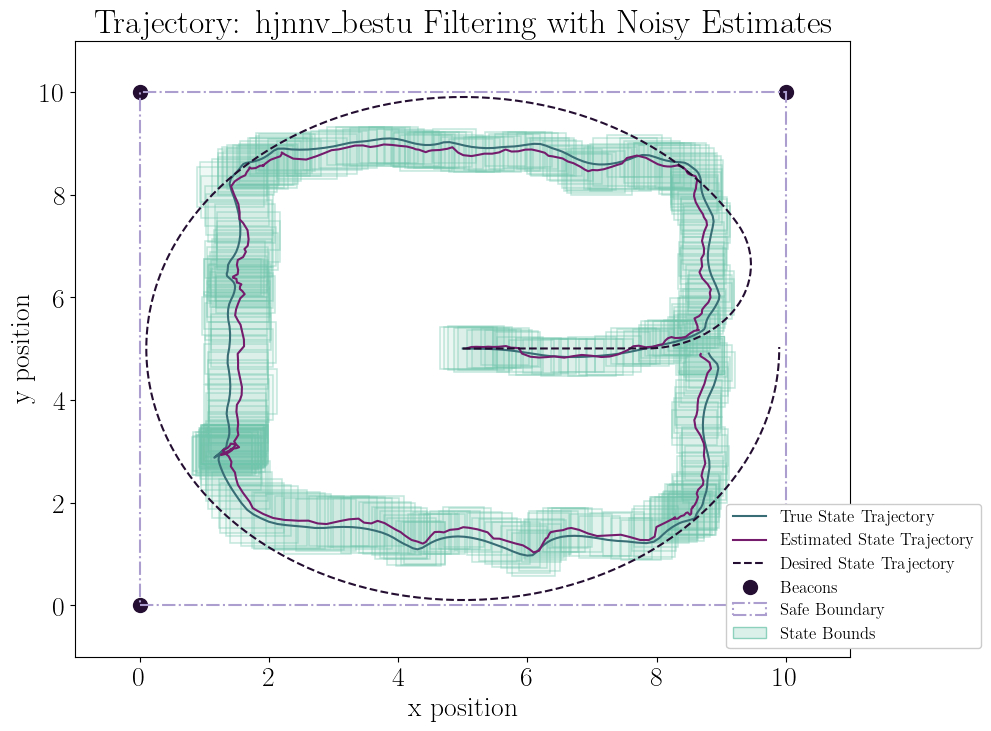

In [12]:


rgb_colors = np.array(pypalettes.load_cmap("Alexandrite").rgb)/255.0
rgb_colors[2] = rgb_colors[2] * 0.8
black = list(rgb_colors[0])
pink = list(rgb_colors[1])
dark_teal = list(rgb_colors[2])
light_teal = list(rgb_colors[3])
purple = list(rgb_colors[4])
orange = list(rgb_colors[5])
light_purple = list(rgb_colors[6])
teal = list(rgb_colors[7])

# rgb_colors = np.array(pypalettes.load_cmap("Color_Blind").rgb)/255.0
# darkblue = list(rgb_colors[0]) # dark teal
# orange = list(rgb_colors[1]) # pink
# med_grey = list(rgb_colors[2]) # light purple
# dark_grey = list(rgb_colors[3]) # purple
# lightblue = list(rgb_colors[4]) # teal
# red = list(rgb_colors[5])
# darkmed_grey = list(rgb_colors[6])
# lightlightblue = list(rgb_colors[7])


state_history = jnp.stack(state_history)
state_hat_history = jnp.stack(state_hat_history)

t_samples = np.linspace(0, num_steps * dynamics.dt, num_steps)
x_des_history = spline_x(t_samples, 0)
y_des_history = spline_y(t_samples, 0)



plt.figure(figsize=(10, 8))
plt.plot(state_history[:, 0], state_history[:, 1], label="True State Trajectory", c=dark_teal)
plt.plot(state_hat_history[:, 0], state_hat_history[:, 1], label="Estimated State Trajectory", c=purple)
plt.plot(x_des_history, y_des_history, label="Desired State Trajectory", c=black, linestyle='--')
plt.scatter(dynamics.beacons[:, 0], dynamics.beacons[:, 1], color=black, marker='o', label="Beacons", s=100)


plt.gca().add_patch(patches.Rectangle((0, 0), 10, 10, linestyle='-.', linewidth=1.5, edgecolor=light_purple, facecolor='none', label="Safe Boundary"))

for i in range(len(state_bounds_history)):
    bounds = state_bounds_history[i]
    lo = bounds.lo
    hi = bounds.hi
    if i == len(state_bounds_history) - 1:
        rect = plt.Rectangle(
            (lo[0], lo[1]),
            hi[0] - lo[0],
            hi[1] - lo[1],
            linewidth=1,
            edgecolor=teal + [0.75],
            facecolor=teal + [0.25],
            label="State Bounds",
            zorder=0
        )
    else:
        rect = plt.Rectangle(
            (lo[0], lo[1]),
            hi[0] - lo[0],
            hi[1] - lo[1],
            linewidth=1.1,
            edgecolor=teal + [0.4],
            facecolor=teal + [0.05],
            zorder=0
        )
    plt.gca().add_patch(rect)
plt.xlabel("x position")
plt.ylabel("y position")
plt.title("Trajectory: {} Filtering with Noisy Estimates".format(filter_type))
plt.legend(loc="lower right", bbox_to_anchor=(1.18, 0.0), framealpha=1.0, fontsize=12)
plt.xlim(-1, 11)
plt.ylim(-1, 11)
# plt.grid(True)
plt.show()

/tmp/ipykernel_364682/1768129927.py:39: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  state_sample_points = ax.scatter([], [], c=orange, marker='.', s=1)


Animating frame 0/345
Animating frame 1/345
Animating frame 2/345
Animating frame 3/345
Animating frame 4/345
Animating frame 5/345
Animating frame 6/345
Animating frame 7/345
Animating frame 8/345
Animating frame 9/345
Animating frame 10/345
Animating frame 11/345
Animating frame 12/345
Animating frame 13/345
Animating frame 14/345
Animating frame 15/345
Animating frame 16/345
Animating frame 17/345
Animating frame 18/345
Animating frame 19/345
Animating frame 20/345
Animating frame 21/345
Animating frame 22/345
Animating frame 23/345
Animating frame 24/345
Animating frame 25/345
Animating frame 26/345
Animating frame 27/345
Animating frame 28/345
Animating frame 29/345
Animating frame 30/345
Animating frame 31/345
Animating frame 32/345
Animating frame 33/345
Animating frame 34/345
Animating frame 35/345
Animating frame 36/345
Animating frame 37/345
Animating frame 38/345
Animating frame 39/345
Animating frame 40/345
Animating frame 41/345
Animating frame 42/345
Animating frame 43/34

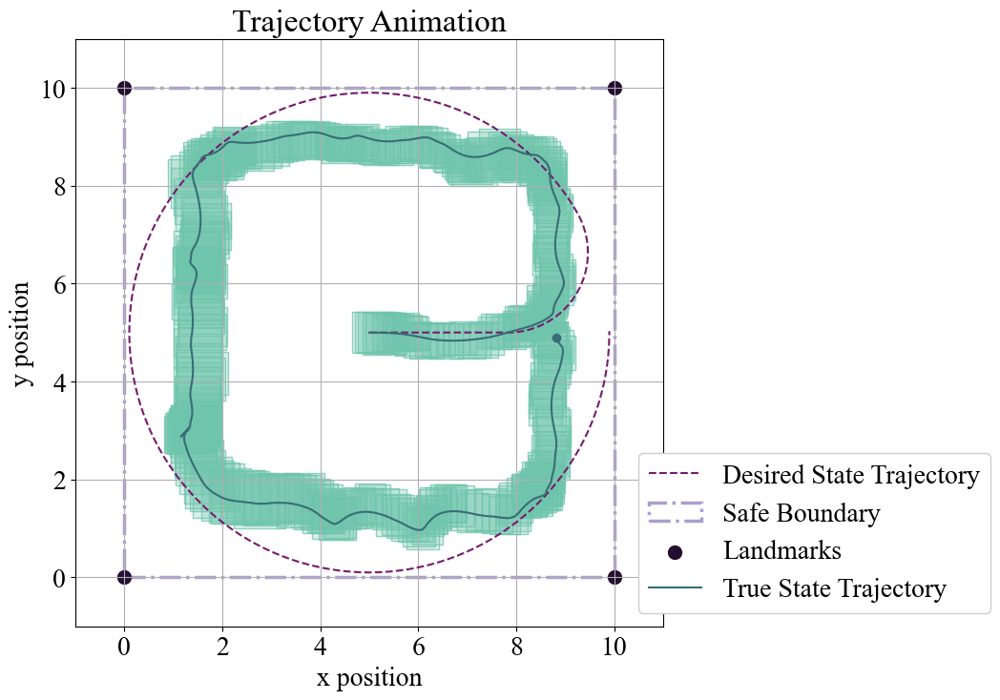

In [29]:
import datetime
import csv
import os

import matplotlib.animation as animation


# Stack histories (already done at the end of your sim)
state_history = jnp.stack(state_history)
state_hat_history = jnp.stack(state_hat_history)
state_des_history = jnp.stack(state_des_history)

t_samples = np.linspace(0, num_steps * dynamics.dt, num_steps)
x_des_history = spline_x(t_samples, 0)
y_des_history = spline_y(t_samples, 0)

# Set up figure
fig, ax = plt.subplots(figsize=(14, 8))
ax.set_xlim(-1, 11)
ax.set_ylim(-1, 11)
ax.set_xlabel("x position")
ax.set_ylabel("y position")
ax.set_title("Trajectory Animation")
ax.grid(True)

# Plot desired trajectory once (static)
ax.plot(x_des_history, y_des_history, '--', c=purple, label="Desired State Trajectory")
# ax.add_patch(patches.Rectangle((0, 0), 10, 10, linestyle='--', linewidth=2, edgecolor=med_grey, facecolor='none'))
ax.add_patch(patches.Rectangle((0, 0), 10, 10, linestyle='-.', linewidth=2.5, edgecolor=light_purple, facecolor='none', label="Safe Boundary"))
plt.scatter(dynamics.beacons[:, 0], dynamics.beacons[:, 1], color=black, marker='o', label="Landmarks", s=100)

# Lines that will be updated
true_line, = ax.plot([], [], '-', label="True State Trajectory", color=dark_teal)
# hat_line, = ax.plot([], [], '-', label="Estimated State Trajectory", color=orange)
true_point, = ax.plot([], [], 'o', markersize=6, color=dark_teal)  # current true state
des_point, = ax.plot([], [], 'o', markersize=6, color=purple)  # current desired state
# hat_point, = ax.plot([], [], 'o', markersize=6, color=orange)  # current estimated state
beacons, = ax.plot([], [], 'o', markersize=6, color=black)  # beacons
state_sample_points = ax.scatter([], [], c=orange, marker='.', s=1)

rect_patch = patches.Rectangle(
    (0, 0), 0, 0, linewidth=1, edgecolor=teal, facecolor='none'
)
ax.add_patch(rect_patch)
ax.set_aspect('equal', 'box')
# ax.legend(loc="upper right")
plt.legend(loc="lower right", bbox_to_anchor=(1.58, 0.0), framealpha=1.0)

# Init function for animation
def init():
    true_line.set_data([], [])
    # hat_line.set_data([], [])
    true_point.set_data([], [])
    # hat_point.set_data([], [])
    des_point.set_data([], [])
    beacons.set_data([], [])
    beacons.set_visible(False)
    state_sample_points.set_offsets(np.empty((0, 2)))
    state_sample_points.set_visible(False)
    des_point.set_visible(False)
    rect_patch.set_visible(False)
    return true_line, true_point, beacons

# Update function for animation
def update(frame):
    print(f"Animating frame {frame}/{num_steps}")
    # Trails
    true_line.set_data(state_history[:frame, 0], state_history[:frame, 1])
    # hat_line.set_data(state_hat_history[:frame, 0], state_hat_history[:frame, 1])
    # Current points (wrapped in lists!)
    true_point.set_data([state_history[frame, 0]], [state_history[frame, 1]])
    # hat_point.set_data([state_hat_history[frame, 0]], [state_hat_history[frame, 1]])
    des_point.set_data([state_des_history[frame, 0]], [state_des_history[frame, 1]])

    beacons.set_data(dynamics.beacons[:, 0], dynamics.beacons[:, 1])

    # Rectangle bounds at this frame
    lo = state_bounds_history[frame].lo   # shape (2,) -> [x_lo, y_lo]
    hi = state_bounds_history[frame].hi   # shape (2,) -> [x_hi, y_hi]

    rect_patch.set_xy((lo[0], lo[1]))
    rect_patch.set_width(hi[0] - lo[0])
    rect_patch.set_height(hi[1] - lo[1])
    rect_patch.set_visible(True)
    # for i in range(frame + 1):
    #     if i % 10 == 0 or i == len(state_bounds_history) - 1:
    bounds = state_bounds_history[frame]
    lo = bounds.lo
    hi = bounds.hi
    if i == len(state_bounds_history) - 1:
        rect = plt.Rectangle(
            (lo[0], lo[1]),
            hi[0] - lo[0],
            hi[1] - lo[1],
            linewidth=1,
            edgecolor=teal + [0.75],
            facecolor=teal + [0.25],
            label="State Bounds",
            zorder=0
        )
    else:
        rect = plt.Rectangle(
            (lo[0], lo[1]),
            hi[0] - lo[0],
            hi[1] - lo[1],
            linewidth=1,
            edgecolor=teal + [0.75],
            facecolor=teal + [0.05],
            zorder=0
        )
    ax.add_patch(rect)

    state_sample_points.set_offsets(state_sample_history[frame])

    return true_line, true_point, des_point, rect_patch

# Create animation
ani = animation.FuncAnimation(
    fig, update, frames=len(state_history), init_func=init,
    blit=True, interval=20, repeat=False
)

now = datetime.datetime.now().strftime("%Y%m%d_%H%M%S")
filename = f"trajectory_{filter_type}_{now}.mp4"

log_path = f"../results/beacon/{traj_type}/animation_log.csv"
log_exists = os.path.isfile(log_path)

log_fields = [
    "filename",
    "traj_type",
    "num_steps",
    "worst_val"
]

log_row = {
    "filename": filename,
    "traj_type": traj_type,
    "num_steps": num_steps,
    "worst_val": float(worst_val)
}

os.makedirs(os.path.dirname(log_path), exist_ok=True)

with open(log_path, "a", newline="") as csvfile:
    writer = csv.DictWriter(csvfile, fieldnames=log_fields)
    if not log_exists:
        writer.writeheader()
    writer.writerow(log_row)

ani.save(f"../results/beacon/animations/{traj_type}/{filename}", writer="ffmpeg", fps=20)

plt.show()

In [13]:
def simulate_filter(dynamics, hjnnv_filter, filter_type, num_steps=None, seed=1, traj_type="spiral", epsilon=0.1, smoothing=True):
    # Good set of experiments to show: No filter, HJ, HJNNV bestu
    sample_type = "observations"

    state_history = []
    state_hat_history = []
    state_bounds_history = []
    state_sample_history = []
    state_des_history = []

    key = jax.random.PRNGKey(seed)
    num_samples = 5000
    dynamics.set_random_seed(seed)
    state = jnp.array([5.0, 5., 1.0, 0.0])
    
    if num_steps is None:
        if traj_type == "lawnmower":
            state = jnp.array([0.5, 0.5, 0.0, 0.0])  # initial state
            num_steps = 1650
        elif traj_type == "spiral":
            state = jnp.array([5., 5., 1.0, 0.0])
            # num_steps = 650
            # num_steps = 700
            num_steps = 345
        elif traj_type == "circle":
            state = jnp.array([8., 5., 0.0, 0.0])
            num_steps = 650
        else:
            state = jnp.array([5.0, 5.0, 0.0, 0.0])  # initial state
            num_steps = 650

    desired_traj = DesiredTrajectory(traj_type)
    state_hat = state
    u = rov_controller(state_hat, desired_traj, 0, kp=2.0, kd=0.5)

    for step in range(num_steps):
        key, subkey = jax.random.split(key)
        t = step * dynamics.dt
        # Simulate the system dynamics
        obs_ = dynamics.get_observation(state, time=step)
        target = jnp.array([5., 5., state_hat[2], state_hat[3]])
        # obs = fgsm(model=dynamics.get_state_estimate, target=target, observation=obs_ , epsilon=epsilon)
        obs = pgd(model=dynamics.get_state_estimate, target=target, observation=obs_, epsilon=epsilon, alpha=0.02, iters=10)
        if smoothing:
            est_obs = jnp.concatenate([state_hat, u, obs])  # append previous state estimate and input
            state_hat = dynamics.get_smoothed_state_distance_estimate(est_obs).flatten()
        else:
            state_hat = dynamics.get_state_estimate(obs).flatten()

        u_nominal = rov_controller(state_hat, desired_traj, t)

        time_start = time.time()
        if filter_type == "hjnnv_maxval" or filter_type == "hjnnv_bestu":
            if smoothing:
                bound_epsilon = jnp.concatenate([1e-8*jnp.ones(6,), epsilon*jnp.ones(12,)])
                state_bounds = hjnnv_filter.nnv_state_bounds(
                    obs=est_obs,
                    eps=bound_epsilon
                )
            else:
                state_bounds = hjnnv_filter.nnv_state_bounds(
                    obs=obs,
                    eps=epsilon
                )

            # if epsilon == 0.1:
            pos_buffer = 5e-2
            vel_buffer = 6.5e-1
            # else:
            #     pos_buffer = 0
            #     vel_buffer = 0
            state_bounds = hj.sets.Box(
                lo=state_bounds.lo - jnp.array([pos_buffer, pos_buffer, vel_buffer, vel_buffer]),
                hi=state_bounds.hi + jnp.array([pos_buffer, pos_buffer, vel_buffer, vel_buffer])
            )

            if filter_type == "hjnnv_maxval":
                v_star, u_star, worst_val, val_filter, min_vals, distances = hjnnv_filter.ua_filter_max_val(
                    u_nominal,
                    state_bounds,
                    num_states=2,
                    eps=1e-6
                )
            elif filter_type == "hjnnv_bestu":
                v_star, u_star, worst_val, val_filter, min_vals, distances, _, _, = hjnnv_filter.ua_filter_best_u(
                    u_nominal,
                    state_bounds,
                    num_states=2,
                    delta=0.01
                )
        elif filter_type == "hj":
            # obs_perturbations = jax.random.uniform(
            #     subkey, shape=(num_samples, obs.shape[0]),
            #     minval=-epsilon, maxval=epsilon
            # )
            # obs_samples = obs + obs_perturbations
            # state_samples_0 = jax.vmap(lambda o: dynamics.get_state_estimate(o).flatten())(obs_samples)
            # # With probability 0.5, pick the state sample furthest from (5,5,0,0), otherwise leave unchanged
            # if jax.random.uniform(subkey) < 0.8:
            #     ref_point = jnp.array([5., 5., 0., 0.])
            #     distances = jnp.linalg.norm(state_samples_0 - ref_point, axis=1)
            #     furthest_idx = jnp.argmin(distances)
            #     state_hat = state_samples_0[furthest_idx]
            
            lo = state_hat - 1e-8
            hi = state_hat + 1e-8
            state_bounds = hj.sets.Box(
                lo,
                hi
            )
            time_start = time.time()
            v_star, u_star, worst_val, val_filter, min_vals, distances = hjnnv_filter.ua_filter_max_val(
                u_nominal,
                state_bounds,
                num_states=2
            )
        elif filter_type == "none":
            u = u_nominal
            v_star = 0.0
            val_filter = 1.0  # positive value means no filtering
            lo = state_hat - 1e-8
            hi = state_hat + 1e-8
            state_bounds = hj.sets.Box(
                lo,
                hi
            )

        if val_filter < 0.0:
            u = u_star
            # print(f"Step {step}: Using filtered control u_star={u}, val_filter={val_filter}")
            # mask = min_vals >= (v_star - 1e-7)  # candidates within tolerance
            # print(f"Step {step}: min_vals_masked={jnp.where(mask, distances, jnp.inf)}")
            # best_idx = jnp.argmin(jnp.where(mask, distances, jnp.inf))
            # print(f"Step {step}: best_idx={best_idx}, u_best={hjnnv_filter.control_vals[best_idx]}, v_best={min_vals[best_idx]}, dist_best={distances[best_idx]}")
            # print(f"Step {step}: Max min_vals={max(min_vals)}")
        else:
            u = u_nominal
        time_end = time.time()

        obs_perturbations = jax.random.uniform(
            subkey, shape=(num_samples, obs.shape[0]),
            minval=-epsilon, maxval=epsilon
        )
        obs_samples = obs + obs_perturbations

        if sample_type == "observations":
            state_samples_0 = jax.vmap(lambda o: dynamics.get_state_estimate(o).flatten())(obs_samples)
        elif sample_type == "state_bounds":
            state_samples_0 = jax.random.uniform(
                subkey, shape=(num_samples, state.shape[0]),
                minval=state_bounds.lo, maxval=state_bounds.hi
            )

        disturbances = jax.vmap(lambda k: dynamics.get_random_disturbance())(
            jax.random.split(subkey, num_samples)
        )

        state_samples = jax.vmap(
            lambda s, d: dynamics.step(s, u_nominal, d, time=step)
        )(state_samples_0, disturbances)

        state_sample_history.append(state_samples)

        # print(f"Step {step}: State: {state}")
        # print(f"Step {step}: Estimated State: {state_hat}")

        # print(f"Step {step}: best_val={v_star}")
        # print(f"Step {step}: state_bounds={state_bounds}")
        # print(f"Step {step}: Filter execution time: {time_end - time_start:.5f} seconds")
        # if step > 194:
        #     print(f"Step {step}: min_vals={min_vals}")

        # Store the state
        # if step == 0:
        state_history.append(state)
        state_hat_history.append(state_hat)
        state_bounds_history.append(state_bounds)
        spline_x, spline_y = desired_traj.generate_trajectory()
        state_des_history.append(jnp.array([spline_x(t, 0), spline_y(t, 0), spline_x(t, 1), spline_y(t, 1)]))

        state = dynamics.step(state, u, dynamics.get_random_disturbance(), time=step)
    
    return state_history, state_hat_history, state_bounds_history, state_des_history

In [14]:
epsilon = 0.05
smoothing = True
smoothing_alpha = 0.9
dt = 0.1
max_input = 5.0
# max_position_disturbance = 0.1
# max_vel_disturbance = 0.01
max_position_disturbance = 1e-3
max_vel_disturbance = 1e-3
seed = 1
# model_name="simple_estimator_3t_long_range"
# model_name="simple_estimator_3t"
# model_name="square_landmark_estimator"

grid = hj.Grid.from_lattice_parameters_and_boundary_conditions(
            hj.sets.Box(
                np.array([-5., -5., -5., -5.]),
                np.array([15., 15., 5., 5.])),
            (30, 30, 20, 20),
        )
values_ = jnp.stack([jnp.abs(grid.states[..., 0] - 5.), jnp.abs(grid.states[..., 1] - 5.)], axis=-1)
values = -jnp.max(values_, axis=-1) + 5.

solver_settings = hj.SolverSettings.with_accuracy("very_high",
                                                  hamiltonian_postprocessor=hj.solver.backwards_reachable_tube)

model_name="square_landmark_estimator"

square_dynamics = BeaconDynamics(
    dt=dt,
    max_input=max_input,
    max_position_disturbance=max_position_disturbance,
    max_vel_disturbance=max_vel_disturbance,
    range_disturbance=epsilon,
    model_name=model_name,
    random_seed=seed
)

if smoothing:
    square_estimation_function = functools.partial(square_dynamics.get_smoothed_state_distance_estimate, alpha=smoothing_alpha)
else:
    square_estimation_function = square_dynamics.get_state_estimate

square_hjnnv_filter = hjnnvUncertaintyAwareFilter(
    dynamics=square_dynamics,
    pred_model=square_estimation_function,
    grid=grid,
    initial_values=values,
    num_controls=30,
    num_disturbances=2
)

# -----------------------------------------
model_name="diagonal_landmark_estimator"

diagonal_dynamics = BeaconDynamics(
    dt=dt,
    max_input=max_input,
    max_position_disturbance=max_position_disturbance,
    max_vel_disturbance=max_vel_disturbance,
    range_disturbance=epsilon,
    model_name=model_name,
    random_seed=seed
)

if smoothing:
    diagonal_estimation_function = functools.partial(diagonal_dynamics.get_smoothed_state_distance_estimate, alpha=smoothing_alpha)
else:
    diagonal_estimation_function = diagonal_dynamics.get_state_estimate

diagonal_hjnnv_filter = hjnnvUncertaintyAwareFilter(
    dynamics=diagonal_dynamics,
    pred_model=diagonal_estimation_function,
    grid=grid,
    initial_values=values,
    num_controls=30,
    num_disturbances=2
)


100%|##########| 10.0000/10.0 [00:42<00:00,  4.23s/sim_s]
100%|##########| 10.0000/10.0 [00:41<00:00,  4.18s/sim_s]


In [15]:

diagonal_hj_histories, diagonal_hjnnv_histories = [], []
square_hj_histories, square_hjnnv_histories = [], []
num_simulations = 20

for i in range(num_simulations):
    print(f"Running diagonal simulation {i+1}/{num_simulations} with HJ filter")
    history = simulate_filter(diagonal_dynamics, diagonal_hjnnv_filter, filter_type="hj", seed=i)
    diagonal_hj_histories.append(history)

for i in range(num_simulations):
    print(f"Running diagonal simulation {i+1}/{num_simulations} with HJNNV filter")
    history = simulate_filter(diagonal_dynamics, diagonal_hjnnv_filter, filter_type="hjnnv_bestu", seed=i)
    diagonal_hjnnv_histories.append(history)

for i in range(num_simulations):
    print(f"Running square simulation {i+1}/{num_simulations} with HJ filter")
    history = simulate_filter(square_dynamics, square_hjnnv_filter, filter_type="hj", seed=i)
    square_hj_histories.append(history)

for i in range(num_simulations):
    print(f"Running square simulation {i+1}/{num_simulations} with HJNNV filter")
    history = simulate_filter(square_dynamics, square_hjnnv_filter, filter_type="hjnnv_bestu", seed=i)
    square_hjnnv_histories.append(history)


Running diagonal simulation 1/20 with HJ filter
Running diagonal simulation 2/20 with HJ filter
Running diagonal simulation 3/20 with HJ filter
Running diagonal simulation 4/20 with HJ filter
Running diagonal simulation 5/20 with HJ filter
Running diagonal simulation 6/20 with HJ filter
Running diagonal simulation 7/20 with HJ filter
Running diagonal simulation 8/20 with HJ filter
Running diagonal simulation 9/20 with HJ filter
Running diagonal simulation 10/20 with HJ filter
Running diagonal simulation 11/20 with HJ filter
Running diagonal simulation 12/20 with HJ filter
Running diagonal simulation 13/20 with HJ filter
Running diagonal simulation 14/20 with HJ filter
Running diagonal simulation 15/20 with HJ filter
Running diagonal simulation 16/20 with HJ filter
Running diagonal simulation 17/20 with HJ filter
Running diagonal simulation 18/20 with HJ filter
Running diagonal simulation 19/20 with HJ filter
Running diagonal simulation 20/20 with HJ filter
Running diagonal simulation 1

/home/nick/.pyenv/versions/3.10.3/envs/hjnnv/lib/python3.10/site-packages/jax/_src/linear_util.py:396: DeprecationWarning: Passing arguments 'a', 'a_min' or 'a_max' to jax.numpy.clip is deprecated. Please use 'arr', 'min' or 'max' respectively instead.
  ans = _fun(*args, **kwargs)
/home/nick/.pyenv/versions/3.10.3/envs/hjnnv/lib/python3.10/site-packages/jax/_src/linear_util.py:396: DeprecationWarning: Passing arguments 'a', 'a_min' or 'a_max' to jax.numpy.clip is deprecated. Please use 'arr', 'min' or 'max' respectively instead.
  ans = _fun(*args, **kwargs)
/home/nick/.pyenv/versions/3.10.3/envs/hjnnv/lib/python3.10/site-packages/jax/_src/linear_util.py:396: DeprecationWarning: Passing arguments 'a', 'a_min' or 'a_max' to jax.numpy.clip is deprecated. Please use 'arr', 'min' or 'max' respectively instead.
  ans = _fun(*args, **kwargs)
/home/nick/.pyenv/versions/3.10.3/envs/hjnnv/lib/python3.10/site-packages/jax/_src/linear_util.py:396: DeprecationWarning: Passing arguments 'a', 'a_mi

Running diagonal simulation 2/20 with HJNNV filter
Running diagonal simulation 3/20 with HJNNV filter
Running diagonal simulation 4/20 with HJNNV filter
Running diagonal simulation 5/20 with HJNNV filter
Running diagonal simulation 6/20 with HJNNV filter
Running diagonal simulation 7/20 with HJNNV filter
Running diagonal simulation 8/20 with HJNNV filter
Running diagonal simulation 9/20 with HJNNV filter
Running diagonal simulation 10/20 with HJNNV filter
Running diagonal simulation 11/20 with HJNNV filter
Running diagonal simulation 12/20 with HJNNV filter
Running diagonal simulation 13/20 with HJNNV filter
Running diagonal simulation 14/20 with HJNNV filter
Running diagonal simulation 15/20 with HJNNV filter
Running diagonal simulation 16/20 with HJNNV filter
Running diagonal simulation 17/20 with HJNNV filter
Running diagonal simulation 18/20 with HJNNV filter
Running diagonal simulation 19/20 with HJNNV filter
Running diagonal simulation 20/20 with HJNNV filter
Running square simul

/home/nick/.pyenv/versions/3.10.3/envs/hjnnv/lib/python3.10/site-packages/jax/_src/linear_util.py:396: DeprecationWarning: Passing arguments 'a', 'a_min' or 'a_max' to jax.numpy.clip is deprecated. Please use 'arr', 'min' or 'max' respectively instead.
  ans = _fun(*args, **kwargs)
/home/nick/.pyenv/versions/3.10.3/envs/hjnnv/lib/python3.10/site-packages/jax/_src/linear_util.py:396: DeprecationWarning: Passing arguments 'a', 'a_min' or 'a_max' to jax.numpy.clip is deprecated. Please use 'arr', 'min' or 'max' respectively instead.
  ans = _fun(*args, **kwargs)
/home/nick/.pyenv/versions/3.10.3/envs/hjnnv/lib/python3.10/site-packages/jax/_src/linear_util.py:396: DeprecationWarning: Passing arguments 'a', 'a_min' or 'a_max' to jax.numpy.clip is deprecated. Please use 'arr', 'min' or 'max' respectively instead.
  ans = _fun(*args, **kwargs)
/home/nick/.pyenv/versions/3.10.3/envs/hjnnv/lib/python3.10/site-packages/jax/_src/linear_util.py:396: DeprecationWarning: Passing arguments 'a', 'a_mi

Running square simulation 2/20 with HJNNV filter
Running square simulation 3/20 with HJNNV filter
Running square simulation 4/20 with HJNNV filter
Running square simulation 5/20 with HJNNV filter
Running square simulation 6/20 with HJNNV filter
Running square simulation 7/20 with HJNNV filter
Running square simulation 8/20 with HJNNV filter
Running square simulation 9/20 with HJNNV filter
Running square simulation 10/20 with HJNNV filter
Running square simulation 11/20 with HJNNV filter
Running square simulation 12/20 with HJNNV filter
Running square simulation 13/20 with HJNNV filter
Running square simulation 14/20 with HJNNV filter
Running square simulation 15/20 with HJNNV filter
Running square simulation 16/20 with HJNNV filter
Running square simulation 17/20 with HJNNV filter
Running square simulation 18/20 with HJNNV filter
Running square simulation 19/20 with HJNNV filter
Running square simulation 20/20 with HJNNV filter


In [43]:
def plot_trajectory(ax, dynamics, state_history, state_hat_history, state_bounds_history, labels=False, plot_rects=False, plot_des=True):
    
    state_history = jnp.stack(state_history)
    state_hat_history = jnp.stack(state_hat_history)

    if labels:
        state_trajectory = "True State Trajectory"
        estimated_trajectory = "Estimated State Trajectory"
        desired_trajectory = "Desired Trajectory"
        beacons_label = "Landmarks"
        state_bounds_label = "State Bounds"
        # safe_boundary_label = "Safe Region"
    else:
        state_trajectory = None
        estimated_trajectory = None
        desired_trajectory = None
        beacons_label = None
        state_bounds_label = None
        # safe_boundary_label = None

    state_error = jnp.linalg.norm(state_history - state_hat_history, axis=1)
    state_error = np.convolve(state_error, np.ones(5)/5, mode='same')

    # Normalize error for colormap
    norm = mcolors.Normalize(vmin=state_error.min(), vmax=state_error.max())
    colors = [black, dark_orange, orange]
    cmap = mcolors.LinearSegmentedColormap.from_list("dark_teal_2_purple", colors)

    # Build line segments for the trajectory
    points = state_history[:, :2]
    segments = [points[i:i+2] for i in range(len(points)-1)]
    lc = mcoll.LineCollection(segments, cmap=cmap, norm=norm)
    lc.set_array(state_error[:-1])  # color by local error
    lc.set_linewidth(2.0)

    ax.add_collection(lc)
    
    # ax.plot(state_history[:, 0], state_history[:, 1], label=state_trajectory, c=dark_teal)
    # ax.plot(state_hat_history[:, 0], state_hat_history[:, 1], label=estimated_trajectory, c=purple)
    if plot_des:
        ax.plot(x_des_history, y_des_history, label=desired_trajectory, c='black', linestyle='--', linewidth=1., zorder=5)
        ax.scatter(dynamics.beacons[:, 0], dynamics.beacons[:, 1], color='black', marker='o', label=beacons_label, s=100, zorder=10)

    
    if plot_rects:
        for i in range(len(state_bounds_history)):
            bounds = state_bounds_history[i]
            lo = bounds.lo
            hi = bounds.hi
            if i == len(state_bounds_history) - 1:
                rect = plt.Rectangle(
                    (lo[0], lo[1]),
                    hi[0] - lo[0],
                    hi[1] - lo[1],
                    linewidth=1,
                    edgecolor=teal + [0.75],
                    facecolor=teal + [0.25],
                    label=state_bounds_label,
                    zorder=0
                )
            else:
                rect = plt.Rectangle(
                    (lo[0], lo[1]),
                    hi[0] - lo[0],
                    hi[1] - lo[1],
                    linewidth=1.1,
                    edgecolor=teal + [0.4],
                    facecolor=teal + [0.05],
                    zorder=0
                )
            ax.add_patch(rect)
    return lc

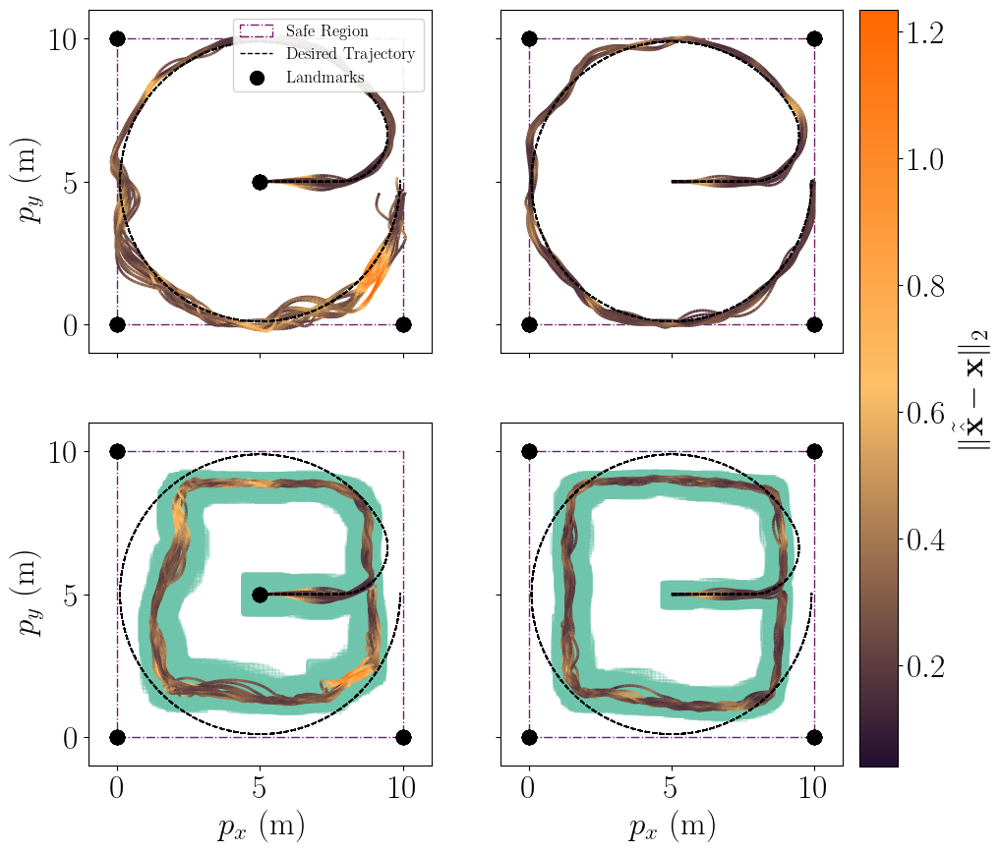

In [33]:
plt.rcParams['font.size'] = 24                 # set global font size

state_history = jnp.stack(state_history)
state_hat_history = jnp.stack(state_hat_history)

t_samples = np.linspace(0, num_steps * dynamics.dt, num_steps)
x_des_history = spline_x(t_samples, 0)
y_des_history = spline_y(t_samples, 0)
line_collections = []

fig, axs = plt.subplots(2, 2, figsize=(11, 10))
ax_dict = {
    (0, 0): {
        "histories": diagonal_hj_histories,
        "dynamics": diagonal_dynamics,
        "filter_type": "hj",
        "xlabel": False,
        "ylabel": True
    },
    (0, 1): {
        "histories": square_hj_histories,
        "dynamics": square_dynamics,
        "filter_type": "hj",
        "xlabel": False,
        "ylabel": False
    },
    (1, 0): {
        "histories": diagonal_hjnnv_histories,
        "dynamics": diagonal_dynamics,
        "filter_type": "hjnnv",
        "xlabel": True,
        "ylabel": True
    },
    (1, 1): {
        "histories": square_hjnnv_histories,
        "dynamics": square_dynamics,
        "filter_type": "hjnnv",
        "xlabel": True,
        "ylabel": False
    }
}

for (ax, sim_config) in zip(axs.flatten(), ax_dict.values()):
    histories = sim_config["histories"]
    dynamics = sim_config["dynamics"]
    filter_type = sim_config["filter_type"]

    safe_boundary_label = "Safe Region"
    safe_region_alpha = 0.0
    # unsafe_region_alpha = 0.4
    ax.add_patch(patches.Rectangle((0, 0), 10, 10, linestyle='-.', linewidth=1., edgecolor=purple, facecolor=purple + [safe_region_alpha], label=safe_boundary_label))
    # ax.add_patch(patches.Rectangle((-1, 0), 1, 10, linestyle='-.', linewidth=1., edgecolor=None, facecolor=orange + [unsafe_region_alpha]))
    # ax.add_patch(patches.Rectangle((10, 0), 1, 10, linestyle='-.', linewidth=1., edgecolor=None, facecolor=orange + [unsafe_region_alpha]))
    # ax.add_patch(patches.Rectangle((-1, -1), 12, 1, linestyle='-.', linewidth=1., edgecolor=None, facecolor=orange + [unsafe_region_alpha]))
    # ax.add_patch(patches.Rectangle((-1, 10), 12, 1, linestyle='-.', linewidth=1., edgecolor=None, facecolor=orange + [unsafe_region_alpha]))

    for i, (state_history, state_hat_history, state_bounds_history, _) in enumerate(histories):
        labels = False
        plot_rects = False
        if i == 0:
            labels = True
        if filter_type == "hjnnv":
            plot_rects = True
        lc = plot_trajectory(ax, dynamics, state_history, state_hat_history, state_bounds_history, labels=labels, plot_rects=plot_rects)
        line_collections.append(lc)

    if sim_config["xlabel"]:
        ax.set_xlabel(r"$p_x$ (m)")
    else:
        ax.set_xticklabels([])
    if sim_config["ylabel"]:
        ax.set_ylabel(r"$p_y$ (m)")
    else:
        ax.set_yticklabels([])
    # plt.title("Trajectory: {} Filtering with Noisy Estimates".format(filter_type))
    # plt.legend(loc="upper right", framealpha=1.0, fontsize=12)
    ax.set_xticks([0, 5.0, 10.0])
    ax.set_yticks([0, 5.0, 10.0])
    ax.set_xlim(-1, 11)
    ax.set_ylim(-1, 11)
    ax.set_aspect('equal', 'box')
    # ax.set_facecolor("lightgray")
    # plt.gca().set_aspect('equal', 'box')
    # plt.grid(True)

# --- Compute global min and max from LineCollections ---
all_errors = np.concatenate([lc.get_array() for lc in line_collections])
global_min, global_max = all_errors.min(), all_errors.max()

# --- Shared colormap and normalization ---
colors = [black, orange, dark_orange]
cmap = mcolors.LinearSegmentedColormap.from_list("dark_teal_2_purple", colors)
norm = mcolors.Normalize(vmin=global_min, vmax=global_max)

# Update each lc to use the shared norm/cmap
for lc in line_collections:
    lc.set_norm(norm)
    lc.set_cmap(cmap)

# --- Single colorbar across all subplots ---
cbar = fig.colorbar(
    plt.cm.ScalarMappable(norm=norm, cmap=cmap),
    ax=axs,
    orientation='vertical',
    fraction=0.08,
    pad=0.02,
    label=r"$\| \tilde{\hat{\mathbf{x}}} - \mathbf{x} \|_2$"
)
axs[0,0].legend(loc="upper right", framealpha=0.9, fontsize=12)

plt.show()

In [18]:
import numpy as np
from numpy.linalg import eig, inv, svd

def jacobian_ranges(p, landmarks):
    # p: (2,) array, landmarks: (N,2)
    d = p - landmarks                # (N,2)
    r = np.linalg.norm(d, axis=1)    # (N,)
    J = d / r[:,None]                # (N,2)  (handles r>0)
    return J

def fim_from_J(J, epsilon=0.1):
    return (1.0 / epsilon**2) * (J.T @ J)  # 2x2

def metrics_at_point(p, landmarks, epsilon=0.1):
    J = jacobian_ranges(p, landmarks)
    F = fim_from_J(J, epsilon)
    # eigen decomposition
    evals, evecs = eig(F)
    # sort
    idx = np.argsort(evals)[::-1]
    evals = evals[idx]
    evecs = evecs[:, idx]
    # if near-singular, handle pseudo-inverse
    cond = np.nan
    if np.min(evals) > 1e-12:
        Pcrlb = inv(F)
        gdop = np.sqrt(np.trace(Pcrlb))
        detF = np.linalg.det(F)
        cond = evals[0] / evals[1]
    else:
        Pcrlb = np.linalg.pinv(F)
        gdop = np.sqrt(np.trace(Pcrlb))
        detF = 0.0
        cond = np.inf
    return {
        "F": F, "evals": evals, "evecs": evecs,
        "Pcrlb": Pcrlb, "gdop": gdop, "detF": detF, "cond": cond
    }

# Example usage:
# lm = np.array([[0.,0.],[1.,0.],[2.,0.],[3.,0.]])  # 4 landmarks on x-axis
landmarks = np.array(dynamics.beacons).reshape(-1, 2)  # Use beacon positions as landmarks
p = np.array([1.5, 0.2])
m = metrics_at_point(p, landmarks, epsilon=0.01)
print("FIM eigenvalues:", m['evals'])
print("Condition number:", m['cond'])
print("GDOP:", m['gdop'])

FIM eigenvalues: [26274.1319853 13725.8680147]
Condition number: 1.9142054955766676
GDOP: 0.010531637392900603


Skipping landmark point at (0.0, 0.0)
Skipping landmark point at (10.0, 10.0)


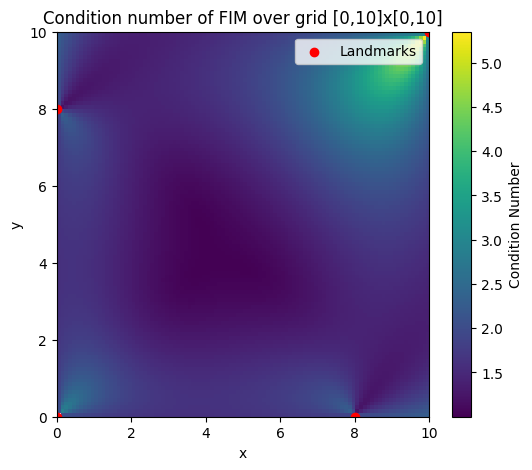

In [ ]:
xs = np.linspace(0.0, 10, 100)
ys = np.linspace(0.0, 10, 100)

cond_vals = np.zeros((len(ys), len(xs)))
for i, x in enumerate(xs):
    for j, y in enumerate(ys):
        # Only skip if both x and y match a landmark exactly
        if not any(np.isclose(x, lx) and np.isclose(y, ly) for lx, ly in landmarks):
            m = metrics_at_point(np.array([x, y]), landmarks, epsilon=0.1)
            cond_vals[j, i] = m['cond']
        else:
            print(f"Skipping landmark point at ({x}, {y})")
            cond_vals[j, i] = np.nan

# Clip very large values for readability
cond_vals_clipped = np.clip(cond_vals, 0, 100)

# --- Plot ---
plt.figure(figsize=(6,5))
plt.imshow(cond_vals_clipped, extent=[0,10,0,10], origin='lower', aspect='auto')
plt.colorbar(label="Condition Number")
plt.scatter(landmarks[:,0], landmarks[:,1], c='red', marker='o', label='Landmarks')
plt.xlabel("x")
plt.ylabel("y")
plt.legend()
plt.title("Condition number of FIM over grid [0,10]x[0,10]")
plt.show()

In [19]:
# model_name="simple_estimator_3t"

# dynamics_worse = BeaconDynamics(
#     dt=dt,
#     max_input=max_input,
#     max_position_disturbance=max_position_disturbance,
#     max_vel_disturbance=max_vel_disturbance,
#     range_disturbance=epsilon,
#     model_name=model_name,
#     random_seed=seed
# )

# if smoothing:
#     estimation_function = functools.partial(dynamics_worse.get_smoothed_state_estimate, alpha=smoothing_alpha)
# else:
#     estimation_function = dynamics_worse.get_state_estimate

# hjnnv_filter_worse = hjnnvUncertaintyAwareFilter(
#     dynamics=dynamics_worse,
#     pred_model=estimation_function,
#     grid=grid,
#     initial_values=values,
#     num_controls=30,
#     num_disturbances=2
# )

# landmarks_worse = np.array(dynamics_worse.beacons).reshape(-1, 2)  # Use beacon positions as landmarks

model_name="diagonal_landmark_estimator"

dynamics_worse = BeaconDynamics(
    dt=dt,
    max_input=max_input,
    max_position_disturbance=max_position_disturbance,
    max_vel_disturbance=max_vel_disturbance,
    range_disturbance=epsilon,
    model_name=model_name,
    random_seed=seed
)
grid = hj.Grid.from_lattice_parameters_and_boundary_conditions(
            hj.sets.Box(
                np.array([-5., -5., -5., -5.]),
                np.array([15., 15., 5., 5.])),
            (30, 30, 20, 20),
        )
values_ = jnp.stack([jnp.abs(grid.states[..., 0] - 5.), jnp.abs(grid.states[..., 1] - 5.)], axis=-1)
values = -jnp.max(values_, axis=-1) + 5.

solver_settings = hj.SolverSettings.with_accuracy("very_high",
                                                  hamiltonian_postprocessor=hj.solver.backwards_reachable_tube)
cmap = 'viridis'

if smoothing:
    estimation_function = functools.partial(dynamics_worse.get_smoothed_state_distance_estimate, alpha=smoothing_alpha)
else:
    estimation_function = dynamics_worse.get_state_estimate

hjnnv_filter_worse = hjnnvUncertaintyAwareFilter(
    dynamics=dynamics_worse,
    pred_model=estimation_function,
    grid=grid,
    initial_values=values,
    num_controls=30,
    num_disturbances=2
)

landmarks_worse = np.array(dynamics_worse.beacons).reshape(-1, 2)  # Use beacon positions as landmarks

100%|##########| 10.0000/10.0 [00:41<00:00,  4.15s/sim_s]


Skipping landmark point at (0.0, 0.0)
Skipping landmark point at (0.0, 10.0)
Skipping landmark point at (10.0, 0.0)


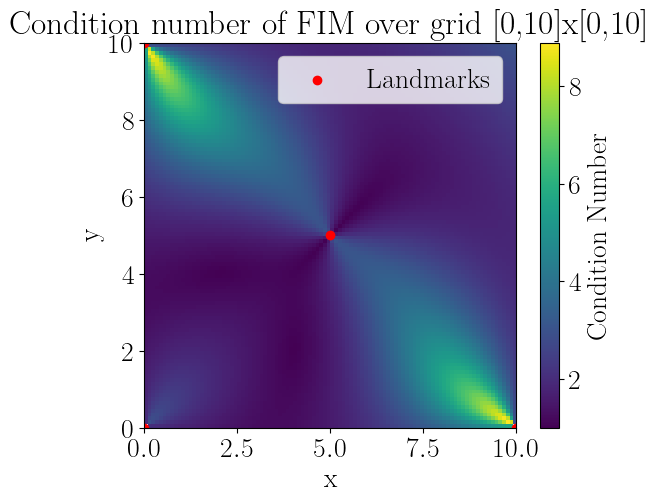

In [23]:
xs = np.linspace(0.0, 10, 100)
ys = np.linspace(0.0, 10, 100)

cond_vals = np.zeros((len(ys), len(xs)))
for i, x in enumerate(xs):
    for j, y in enumerate(ys):
        # Only skip if both x and y match a landmark exactly
        if not any(np.isclose(x, lx) and np.isclose(y, ly) for lx, ly in landmarks_worse):
            m = metrics_at_point(np.array([x, y]), landmarks_worse, epsilon=epsilon)
            cond_vals[j, i] = m['cond']
        else:
            print(f"Skipping landmark point at ({x}, {y})")
            cond_vals[j, i] = np.nan

# Clip very large values for readability
cond_vals_clipped = np.clip(cond_vals, 0, 100)

# --- Plot ---
plt.figure(figsize=(6,5))
plt.imshow(cond_vals_clipped, extent=[0,10,0,10], origin='lower', aspect='auto')
plt.colorbar(label="Condition Number")
plt.scatter(landmarks_worse[:,0], landmarks_worse[:,1], c='red', marker='o', label='Landmarks')
plt.xlabel("x")
plt.ylabel("y")
plt.legend()
plt.title("Condition number of FIM over grid [0,10]x[0,10]")
plt.show()

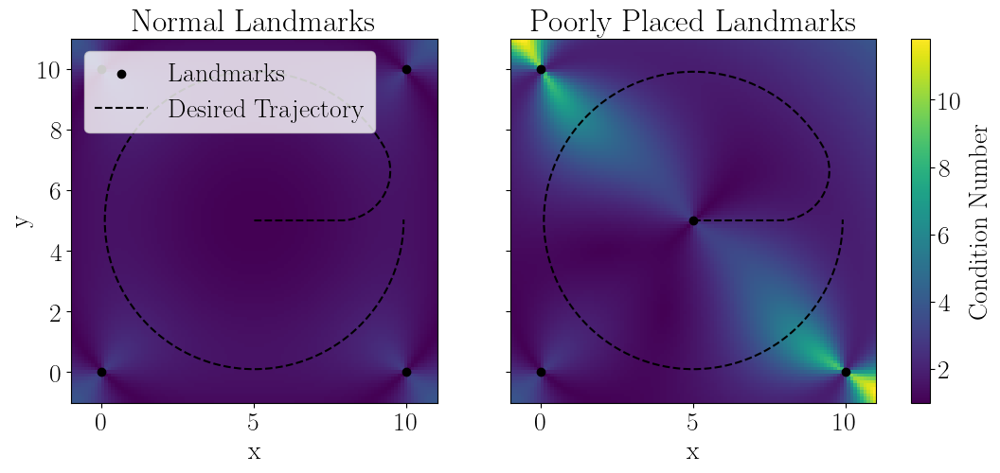

In [25]:
xmin = -1
xmax = 11
ymin = -1
ymax = 11

xs = np.linspace(xmin, xmax, 110)
ys = np.linspace(ymin, ymax, 110)

des_color = 'black'
landmark_color = 'black'

def compute_cond_vals(landmarks):
    cond_vals = np.zeros((len(ys), len(xs)))
    for i, x in enumerate(xs):
        for j, y in enumerate(ys):
            if not any(np.isclose(x, lx) and np.isclose(y, ly) for lx, ly in landmarks):
                m = metrics_at_point(np.array([x, y]), landmarks, epsilon=epsilon)
                cond_vals[j, i] = m['cond']
            else:
                cond_vals[j, i] = np.nan
    return np.clip(cond_vals, 0, 100)

# Compute both
cond_vals_worse = compute_cond_vals(landmarks_worse)
cond_vals = compute_cond_vals(landmarks)

# --- Shared plotting ---
fig, axes = plt.subplots(1, 2, figsize=(12, 5), sharex=True, sharey=True)

# Find global min/max for consistent scaling
vmin = min(np.nanmin(cond_vals), np.nanmin(cond_vals_worse))
vmax = max(np.nanmax(cond_vals), np.nanmax(cond_vals_worse))

# Plot 1
im1 = axes[0].imshow(cond_vals, extent=[xmin, xmax, ymin, ymax],
                     origin='lower', aspect='auto', vmin=vmin, vmax=vmax)
axes[0].scatter(landmarks[:,0], landmarks[:,1], c=landmark_color, marker='o', label="Landmarks")
axes[0].plot(x_des_history, y_des_history, '--', color=des_color, label='Desired Trajectory')
axes[0].set_title("Normal Landmarks")
axes[0].set_xlabel("x")
axes[0].set_ylabel("y")
axes[0].set_xlim(xmin, xmax)
axes[0].set_ylim(ymin, ymax)
axes[0].legend(loc='upper left')

# Plot 2
im2 = axes[1].imshow(cond_vals_worse, extent=[xmin, xmax, ymin, ymax],
                     origin='lower', aspect='auto', vmin=vmin, vmax=vmax)
axes[1].scatter(landmarks_worse[:,0], landmarks_worse[:,1], c=landmark_color, marker='o', label="Landmarks")
axes[1].plot(x_des_history, y_des_history, '--', color=des_color, label='Desired Trajectory')
axes[1].set_title("Poorly Placed Landmarks")
axes[1].set_xlabel("x")
axes[1].set_xlim(xmin, xmax)
axes[1].set_ylim(ymin, ymax)

# Shared colorbar
cbar = fig.colorbar(im1, ax=axes, orientation='vertical', fraction=0.046, pad=0.04)
cbar.set_label("Condition Number")

# plt.tight_layout()
plt.show()

In [26]:
# xs = np.linspace(-0.5, 10.5, 110)
# ys = np.linspace(-0.5, 10.5, 110)

no_noise_dynamics = BeaconDynamics(
    dt=dt,
    max_input=max_input,
    max_position_disturbance=max_position_disturbance,
    max_vel_disturbance=max_vel_disturbance,
    range_disturbance=epsilon,
    model_name=model_name,
    random_seed=seed
)

# def compute_cond_vals(landmarks):
#     cond_vals = np.zeros((len(ys), len(xs)))
#     for i, x in enumerate(xs):
#         for j, y in enumerate(ys):
#             if not any(np.isclose(x, lx) and np.isclose(y, ly) for lx, ly in landmarks):
#                 m = metrics_at_point(np.array([x, y]), landmarks, epsilon=epsilon)
#                 cond_vals[j, i] = m['cond']
#             else:
#                 cond_vals[j, i] = np.nan
#     return np.clip(cond_vals, 0, 100)

def compute_nnv_metric(hjnnv_filter):
    nnv_vals = np.zeros((len(ys), len(xs)))
    for i, x in enumerate(xs):
        for j, y in enumerate(ys):
            if smoothing:
                x_prev = jnp.array([x, y, 0.0, 0.0])
                u_prev = jnp.array([0.0, 0.0])
                obs = no_noise_dynamics.get_observation(jnp.array([x, y, 0.0, 0.0]), time=0)
                est_obs = jnp.concatenate([x_prev, u_prev, obs])
                bound_epsilon = jnp.concatenate([1e-8*jnp.ones(6,), epsilon*jnp.ones(12,)])
                
            else:
                est_obs = no_noise_dynamics.get_observation(jnp.array([x, y, 0.0, 0.0]), time=0)
                bound_epsilon = epsilon
            state_bounds = hjnnv_filter.nnv_state_bounds(
                obs=est_obs,
                eps=bound_epsilon
            )
            # diff = state_bounds.hi[:2] - state_bounds.lo[:2]
            diff = state_bounds.hi - state_bounds.lo
            nnv_vals[j, i] = jnp.prod(diff)
    return nnv_vals

cond_vals_worse = compute_cond_vals(landmarks_worse)
cond_vals = compute_cond_vals(landmarks)

nnv_vals_worse = compute_nnv_metric(hjnnv_filter_worse)
nnv_vals = compute_nnv_metric(hjnnv_filter)

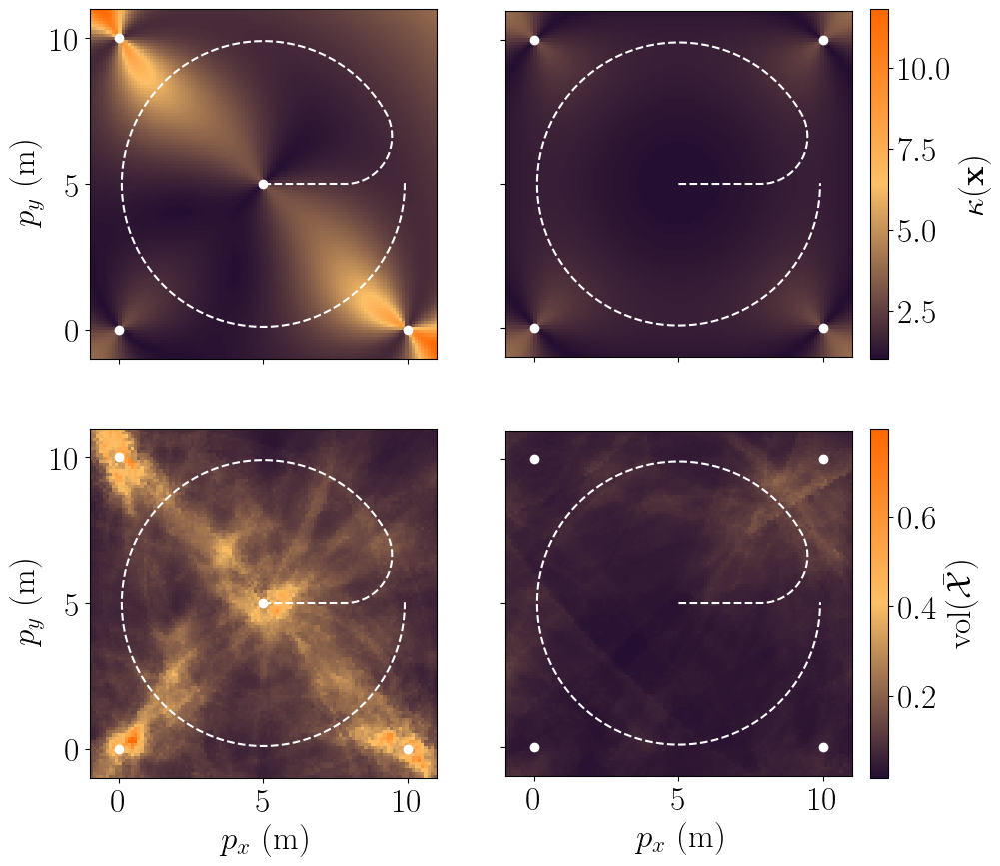

In [36]:
import matplotlib.colors as mcolors

rgb_colors = np.array(pypalettes.load_cmap("Alexandrite").rgb)/255.0
rgb_colors[2] = rgb_colors[2] * 0.8
black = list(rgb_colors[0])
pink = list(rgb_colors[1])
dark_teal = list(rgb_colors[2])
light_teal = list(rgb_colors[3])
purple = list(rgb_colors[4])
orange = list(rgb_colors[5])
yellow = [240/255.0, 225/255.0, 0/255.0]  # yellow
dark_orange = [255/255.0, 103/255.0, 0/255.0]
# gray = [70/255.0, 45/255.0, 255/255.0]  # red
# gray = dark_orange
light_purple = list(rgb_colors[6])
teal = list(rgb_colors[7])
hot_pink = [1.0, 46/255.0, 204/255.0]  # hot pink

plt.rcParams['font.family'] = 'serif'          # e.g., 'sans-serif', 'serif', 'monospace'
plt.rcParams['font.serif'] = ['Times New Roman']  # specify font
plt.rcParams['font.size'] = 24                 # set global font size

xmin = -1
xmax = 11
ymin = -1
ymax = 11

trajectory_color = "white"
landmark_color = trajectory_color

colors = [black, orange, dark_orange]
cmap = mcolors.LinearSegmentedColormap.from_list("dark_teal_2_purple", colors)


# --- Shared plotting ---
fig, axes = plt.subplots(2, 2, figsize=(12, 10), sharex=True, sharey=True)

# Find global min/max for consistent scaling
vmin = min(np.nanmin(cond_vals), np.nanmin(cond_vals_worse))
vmax = max(np.nanmax(cond_vals), np.nanmax(cond_vals_worse))

vmin_nnv = min(np.nanmin(nnv_vals), np.nanmin(nnv_vals_worse))
vmax_nnv = max(np.nanmax(nnv_vals), np.nanmax(nnv_vals_worse))

# Plot 1
im1 = axes[0, 1].imshow(cond_vals, extent=[xmin, xmax, ymin, ymax],
                     origin='lower', aspect='auto', vmin=vmin, vmax=vmax, cmap=cmap)
axes[0, 1].scatter(landmarks[:,0], landmarks[:,1], c=landmark_color, marker='o', label="Landmarks")
axes[0, 1].plot(x_des_history, y_des_history, '--', color=trajectory_color, label='Desired Trajectory')
# axes[0, 0].set_title("Normal Landmarks")
# axes[0, 0].set_xlabel("x position (m)")
axes[0, 0].set_ylabel(r"$p_y$ (m)")
axes[0, 0].set_xlim(xmin, xmax)
axes[0, 0].set_ylim(ymin, ymax)
axes[0, 0].set_aspect('equal', 'box')
axes[0, 0].set_yticks([0, 5, 10])
# axes[0, 0].legend(loc='upper left')

# Plot 2
im2 = axes[0, 0].imshow(cond_vals_worse, extent=[xmin, xmax, ymin, ymax],
                     origin='lower', aspect='auto', vmin=vmin, vmax=vmax, cmap=cmap)
axes[0, 0].scatter(landmarks_worse[:,0], landmarks_worse[:,1], c=landmark_color, marker='o', label="Landmarks")
axes[0, 0].plot(x_des_history, y_des_history, '--', color=trajectory_color, label='Desired Trajectory')
# axes[0, 1].set_title("Poorly Placed Landmarks")
# axes[0, 1].set_xlabel("x position (m)")
axes[0, 1].set_xlim(xmin, xmax)
axes[0, 1].set_ylim(ymin, ymax)
axes[0, 1].set_aspect('equal', 'box')

# Plot 3
im3 = axes[1, 1].imshow(nnv_vals, extent=[xmin, xmax, ymin, ymax],
                     origin='lower', aspect='auto', vmin=vmin_nnv, vmax=vmax_nnv, cmap=cmap)
axes[1, 1].scatter(landmarks[:,0], landmarks[:,1], c=landmark_color, marker='o', label="Landmarks")
axes[1, 1].plot(x_des_history, y_des_history, '--', color=trajectory_color, label='Desired Trajectory')
axes[1, 0].set_xlabel(r"$p_x$ (m)")
axes[1, 0].set_ylabel(r"$p_y$ (m)")
axes[1, 0].set_xlim(xmin, xmax)
axes[1, 0].set_ylim(ymin, ymax)
axes[1, 0].set_aspect('equal', 'box')
axes[1, 0].set_yticks([0, 5, 10])
# axes[1, 0].legend(loc='upper left')

# Plot 4
im4 = axes[1, 0].imshow(nnv_vals_worse, extent=[xmin, xmax, ymin, ymax],
                     origin='lower', aspect='auto', vmin=vmin_nnv, vmax=vmax_nnv, cmap=cmap)
axes[1, 0].scatter(landmarks_worse[:,0], landmarks_worse[:,1], c=landmark_color, marker='o', label="Landmarks")
axes[1, 0].plot(x_des_history, y_des_history, '--', color=trajectory_color, label='Desired Trajectory')
axes[1, 1].set_xlabel(r"$p_x$ (m)")
axes[1, 1].set_xlim(xmin, xmax)
axes[1, 1].set_ylim(ymin, ymax)
axes[1, 1].set_aspect('equal', 'box')

# Shared colorbar for top row (axes[0, :])
cbar_top = fig.colorbar(im1, ax=axes[0, :], orientation='vertical', fraction=0.16, pad=0.02)
cbar_top.set_label(r"$\kappa(\mathbf{x})$")

# Shared colorbar for bottom row (axes[1, :])
cbar_bottom = fig.colorbar(im3, ax=axes[1, :], orientation='vertical', fraction=0.16, pad=0.02)
cbar_bottom.set_label(r"vol$(\bar{\mathcal{X}})$")

# plt.tight_layout()
plt.show()

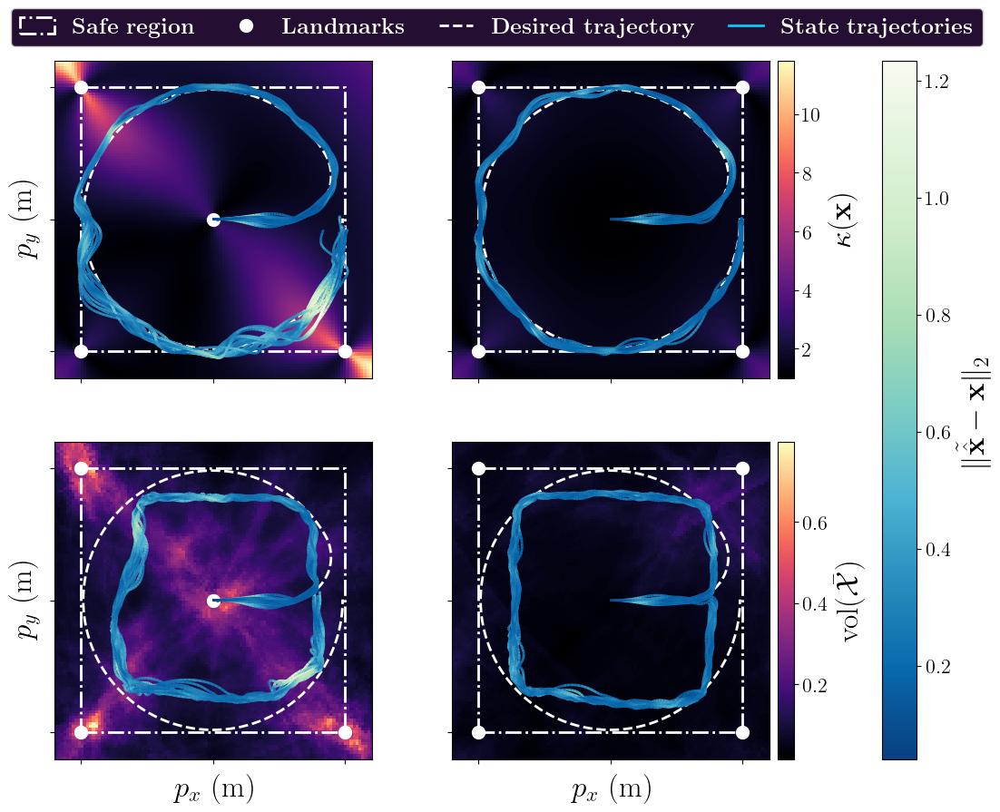

In [ ]:
import matplotlib.colors as mcolors

rgb_colors = np.array(pypalettes.load_cmap("Alexandrite").rgb)/255.0
rgb_colors[2] = rgb_colors[2] * 0.8
black = list(rgb_colors[0])
pink = list(rgb_colors[1])
dark_teal = list(rgb_colors[2])
light_teal = list(rgb_colors[3])
purple = list(rgb_colors[4])
orange = list(rgb_colors[5])
yellow = [240/255.0, 225/255.0, 0/255.0]  # yellow
dark_orange = [255/255.0, 103/255.0, 0/255.0]
# gray = [70/255.0, 45/255.0, 255/255.0]  # red
# gray = dark_orange
light_purple = list(rgb_colors[6])
teal = list(rgb_colors[7])
hot_pink = [1.0, 46/255.0, 204/255.0]  # hot pink

plt.rcParams['font.family'] = 'serif'          # e.g., 'sans-serif', 'serif', 'monospace'
plt.rcParams['font.serif'] = ['Times New Roman']  # specify font
plt.rcParams['font.size'] = 24                 # set global font size

xmin = -1
xmax = 11
ymin = -1
ymax = 11

trajectory_color = "white"
# trajectory_color = "black"
# trajectory_color = [0.0, 0.0, 0.2]
landmark_color = trajectory_color
trajectory_zorder = 0
trajectory_linewidth = 2.0
landmark_size = 100

colors = [black, orange, dark_orange]
cmap = mcolors.LinearSegmentedColormap.from_list("dark_teal_2_purple", colors)
# cmap = 'viridis'
cmap = 'magma'


# --- Shared plotting ---
fig, axes = plt.subplots(2, 2, figsize=(13, 10), sharex=True, sharey=True)

# Find global min/max for consistent scaling
vmin = min(np.nanmin(cond_vals), np.nanmin(cond_vals_worse))
vmax = max(np.nanmax(cond_vals), np.nanmax(cond_vals_worse))

vmin_nnv = min(np.nanmin(nnv_vals), np.nanmin(nnv_vals_worse))
vmax_nnv = max(np.nanmax(nnv_vals), np.nanmax(nnv_vals_worse))

# Plot 1
im1 = axes[0, 1].imshow(cond_vals, extent=[xmin, xmax, ymin, ymax],
                     origin='lower', aspect='auto', vmin=vmin, vmax=vmax, cmap=cmap)
axes[0, 1].scatter(
    landmarks[:,0],
    landmarks[:,1],
    c=landmark_color,
    marker='o',
    s=landmark_size,
    label="Landmarks",
    zorder=trajectory_zorder
)
axes[0, 1].plot(
    x_des_history,
    y_des_history,
    '--',
    linewidth=trajectory_linewidth,
    color=trajectory_color,
    label='Desired Trajectory', 
    zorder=trajectory_zorder
)
# axes[0, 0].set_title("Normal Landmarks")
# axes[0, 0].set_xlabel("x position (m)")
axes[0, 0].set_ylabel(r"$p_y$ (m)")
axes[0, 0].set_xlim(xmin, xmax)
axes[0, 0].set_ylim(ymin, ymax)
axes[0, 0].set_aspect('equal', 'box')
axes[0, 0].set_yticks([0, 5, 10])
# axes[0, 0].legend(loc='upper left')

# Plot 2
im2 = axes[0, 0].imshow(cond_vals_worse, extent=[xmin, xmax, ymin, ymax],
                     origin='lower', aspect='auto', vmin=vmin, vmax=vmax, cmap=cmap)
axes[0, 0].scatter(
    landmarks_worse[:,0],
    landmarks_worse[:,1],
    c=landmark_color,
    marker='o',
    s=landmark_size,
    label="Landmarks",
    zorder=trajectory_zorder
)
axes[0, 0].plot(
    x_des_history,
    y_des_history,
    '--',
    linewidth=trajectory_linewidth,
    color=trajectory_color,
    label='Desired Trajectory', 
    zorder=trajectory_zorder
)
# axes[0, 1].set_title("Poorly Placed Landmarks")
# axes[0, 1].set_xlabel("x position (m)")
axes[0, 1].set_xlim(xmin, xmax)
axes[0, 1].set_ylim(ymin, ymax)
axes[0, 1].set_aspect('equal', 'box')

# Plot 3
im3 = axes[1, 1].imshow(nnv_vals, extent=[xmin, xmax, ymin, ymax],
                     origin='lower', aspect='auto', vmin=vmin_nnv, vmax=vmax_nnv, cmap=cmap)
axes[1, 1].scatter(
    landmarks[:,0],
    landmarks[:,1],
    c=landmark_color,
    marker='o',
    s=landmark_size,
    label="Landmarks",
    zorder=trajectory_zorder
)
axes[1, 1].plot(
    x_des_history,
    y_des_history,
    '--',
    linewidth=trajectory_linewidth,
    color=trajectory_color,
    label='Desired Trajectory', 
    zorder=trajectory_zorder
)
axes[1, 0].set_xlabel(r"$p_x$ (m)")
axes[1, 0].set_ylabel(r"$p_y$ (m)")
axes[1, 0].set_xlim(xmin, xmax)
axes[1, 0].set_ylim(ymin, ymax)
axes[1, 0].set_aspect('equal', 'box')
axes[1, 0].set_yticks([0, 5, 10])
# axes[1, 0].legend(loc='upper left')

# Plot 4
im4 = axes[1, 0].imshow(nnv_vals_worse, extent=[xmin, xmax, ymin, ymax],
                     origin='lower', aspect='auto', vmin=vmin_nnv, vmax=vmax_nnv, cmap=cmap)
axes[1, 0].scatter(
    landmarks_worse[:,0],
    landmarks_worse[:,1],
    c=landmark_color,
    marker='o',
    s=landmark_size,
    label="Landmarks",
    zorder=trajectory_zorder
)
axes[1, 0].plot(
    x_des_history,
    y_des_history,
    '--',
    linewidth=trajectory_linewidth,
    color=trajectory_color,
    label='Desired Trajectory', 
    zorder=trajectory_zorder
)
axes[1, 1].set_xlabel(r"$p_x$ (m)")
axes[1, 1].set_xlim(xmin, xmax)
axes[1, 1].set_ylim(ymin, ymax)
axes[1, 1].set_aspect('equal', 'box')




# 2nd plot overlay
plt.rcParams['font.size'] = 24                 # set global font size

state_history = jnp.stack(state_history)
state_hat_history = jnp.stack(state_hat_history)

t_samples = np.linspace(0, num_steps * dynamics.dt, num_steps)
x_des_history = spline_x(t_samples, 0)
y_des_history = spline_y(t_samples, 0)
line_collections = []

# fig, axs = plt.subplots(2, 2, figsize=(11, 10))
ax_dict = {
    (0, 0): {
        "histories": diagonal_hj_histories,
        "dynamics": diagonal_dynamics,
        "filter_type": "hj",
        "xlabel": False,
        "ylabel": True
    },
    (0, 1): {
        "histories": square_hj_histories,
        "dynamics": square_dynamics,
        "filter_type": "hj",
        "xlabel": False,
        "ylabel": False
    },
    (1, 0): {
        "histories": diagonal_hjnnv_histories,
        "dynamics": diagonal_dynamics,
        "filter_type": "hjnnv",
        "xlabel": True,
        "ylabel": True
    },
    (1, 1): {
        "histories": square_hjnnv_histories,
        "dynamics": square_dynamics,
        "filter_type": "hjnnv",
        "xlabel": True,
        "ylabel": False
    }
}

for (ax, sim_config) in zip(axes.flatten(), ax_dict.values()):
    histories = sim_config["histories"]
    dynamics = sim_config["dynamics"]
    filter_type = sim_config["filter_type"]

    safe_boundary_label = "Safe Region"
    safe_region_alpha = 0.0
    # unsafe_region_alpha = 0.4
    ax.add_patch(
        patches.Rectangle(
            (0, 0),
            10,
            10,
            linestyle='-.',
            linewidth=trajectory_linewidth,
            edgecolor=landmark_color,
            facecolor=purple + [safe_region_alpha],
            label=safe_boundary_label,
            zorder=trajectory_zorder
        )
    )
    # ax.add_patch(patches.Rectangle((-1, 0), 1, 10, linestyle='-.', linewidth=1., edgecolor=None, facecolor=orange + [unsafe_region_alpha]))
    # ax.add_patch(patches.Rectangle((10, 0), 1, 10, linestyle='-.', linewidth=1., edgecolor=None, facecolor=orange + [unsafe_region_alpha]))
    # ax.add_patch(patches.Rectangle((-1, -1), 12, 1, linestyle='-.', linewidth=1., edgecolor=None, facecolor=orange + [unsafe_region_alpha]))
    # ax.add_patch(patches.Rectangle((-1, 10), 12, 1, linestyle='-.', linewidth=1., edgecolor=None, facecolor=orange + [unsafe_region_alpha]))

    for i, (state_history, state_hat_history, state_bounds_history, _) in enumerate(histories):
        labels = False
        plot_rects = False
        if i == 0:
            labels = False
        if filter_type == "hjnnv":
            plot_rects = False
        lc = plot_trajectory(ax, dynamics, state_history, state_hat_history, state_bounds_history, labels=labels, plot_rects=plot_rects, plot_des=False)
        line_collections.append(lc)

    if sim_config["xlabel"]:
        ax.set_xlabel(r"$p_x$ (m)")
    else:
        ax.set_xticklabels([])
    if sim_config["ylabel"]:
        ax.set_ylabel(r"$p_y$ (m)")
    else:
        ax.set_yticklabels([])
    # plt.title("Trajectory: {} Filtering with Noisy Estimates".format(filter_type))
    # plt.legend(loc="upper right", framealpha=1.0, fontsize=12)
    ax.set_xticks([0, 5.0, 10.0])
    ax.set_yticks([0, 5.0, 10.0])
    ax.set_xlim(-1, 11)
    ax.set_ylim(-1, 11)
    ax.set_aspect('equal', 'box')
    # ax.set_facecolor("lightgray")
    # plt.gca().set_aspect('equal', 'box')
    # plt.grid(True)

# # --- Compute global min and max from LineCollections ---
# all_errors = np.concatenate([lc.get_array() for lc in line_collections])
# global_min, global_max = all_errors.min(), all_errors.max()

# # --- Shared colormap and normalization ---
# # colors = [black, orange, dark_orange]
# colors = ['white', hot_pink, 'black']
# cmap = mcolors.LinearSegmentedColormap.from_list("dark_teal_2_purple", colors)
# # cmap = 'YlGnBu_r'
# cmap = 'GnBu_r'
# # cmap = 'Greys_r'
# norm = mcolors.Normalize(vmin=global_min, vmax=global_max)

# # Update each lc to use the shared norm/cmap
# for lc in line_collections:
#     lc.set_norm(norm)
#     lc.set_cmap(cmap)

# # --- Single colorbar across all subplots ---
# cbar = fig.colorbar(
#     plt.cm.ScalarMappable(norm=norm, cmap=cmap),
#     ax=axes,
#     orientation='vertical',
#     fraction=0.08,
#     pad=-0.04,
#     label=r"$\| \tilde{\hat{\mathbf{x}}} - \mathbf{x} \|_2$"
# )

# little_cbar_pad = 0.01
# # Shared colorbar for top row (axes[0, :])
# cbar_top = fig.colorbar(
#     im1,
#     ax=axes[0, :],
#     orientation='vertical',
#     fraction=0.16, 
#     pad=little_cbar_pad
# )
# cbar_top.set_label(r"$\kappa(\mathbf{x})$")

# # Shared colorbar for bottom row (axes[1, :])
# cbar_bottom = fig.colorbar(
#     im3,
#     ax=axes[1, :],
#     orientation='vertical',
#     fraction=0.16, 
#     pad=little_cbar_pad
# )
# cbar_bottom.set_label(r"vol$(\bar{\mathcal{X}})$")

# cbar_fontsize = 16
# cbar.ax.tick_params(labelsize=cbar_fontsize)
# cbar_top.ax.tick_params(labelsize=cbar_fontsize)
# cbar_bottom.ax.tick_params(labelsize=cbar_fontsize)



# legend_handles = []

# # --- Landmarks ---
# legend_handles.append(
#     Line2D(
#         [0], [0],
#         marker='o',
#         linestyle='None',
#         markersize=np.sqrt(landmark_size),
#         markerfacecolor=landmark_color,
#         markeredgecolor=landmark_color,
#         label=r'\textbf{Landmarks}'
#     )
# )

# # --- Desired trajectory ---
# legend_handles.append(
#     Line2D(
#         [0], [0],
#         linestyle='--',
#         linewidth=trajectory_linewidth,
#         color=trajectory_color,
#         label=r'\textbf{Desired trajectory}'
#     )
# )

# # --- Safe region boundary ---
# legend_handles.append(
#     patches.Patch(
#         facecolor='none',
#         edgecolor=landmark_color,
#         linestyle='-.',
#         linewidth=trajectory_linewidth,
#         label=r'\textbf{Safe region}'
#     )
# )

# # --- HJ-NNV trajectory ---
# legend_handles.append(
#     Line2D(
#         [0], [0],
#         linewidth=trajectory_linewidth,
#         color=[0.0, 0.8, 1.0],
#         label=r'\textbf{State trajectories}'
#     )
# )

# legend_order = [
#     r'\textbf{Safe region}',
#     r'\textbf{Landmarks}',
#     r'\textbf{Desired trajectory}',
#     r'\textbf{State trajectories}'
# ]

# handles_dict = {h.get_label(): h for h in legend_handles}
# ordered_handles = [handles_dict[k] for k in legend_order]

# axes[0,0].legend(
#     handles=ordered_handles,
#     loc="upper right",
#     facecolor=black,
#     labelcolor="white",
#     framealpha=1.0,
#     fontsize=18,
#     bbox_to_anchor=(2.96, 1.2),
#     ncol=4,
#     handlelength=1.5,
#     columnspacing=1.5,
# )

# axes[0,0].legend(
#     handles=legend_handles,
#     loc="upper right",
#     facecolor=black,
#     labelcolor="white",
#     framealpha=1.0,
#     fontsize=16,
#     bbox_to_anchor=(2.05, 1.18),
#     ncol=3,
#     handlelength=2.5,
#     columnspacing=1.5
# )


# axes[0,0].legend(
#     loc="upper right",
#     facecolor=black,
#     labelcolor="white",
#     framealpha=1.0,
#     fontsize=16,
#     bbox_to_anchor=(2.0, 1.18),
#     ncol=3
# )

# plt.tight_layout()
plt.show()

In [ ]:
num_samples = 30
xs = np.linspace(-0.5, 10.5, 40)
ys = np.linspace(-0.5, 10.5, 40)

def compute_sampled_metric(dynamics):
    subkey, _ = jax.random.split(key)
    sampled_vals = np.zeros((len(ys), len(xs)))
    obs_perturbations = jax.random.uniform(
        subkey, shape=(num_samples, 12),
        minval=-epsilon, maxval=epsilon
    )
    for i, x in enumerate(xs):
        for j, y in enumerate(ys):
            lo = jnp.inf * jnp.ones(4,)
            hi = -jnp.inf * jnp.ones(4,)
            if smoothing:
                x_prev = jnp.array([x, y, 0.0, 0.0])
                u_prev = jnp.array([0.0, 0.0])
                obs = no_noise_dynamics.get_observation(jnp.array([x, y, 0.0, 0.0]), time=0)
                obs_samples = obs + obs_perturbations
                for k in range(num_samples):
                    est_obs = jnp.concatenate([x_prev, u_prev, obs_samples[k]])
                    state_est = dynamics.get_smoothed_state_estimate(est_obs, smoothing_alpha).flatten()
                    lo = jnp.min(jnp.vstack([lo, state_est]), axis=0)
                    hi = jnp.max(jnp.vstack([hi, state_est]), axis=0)

            else:
                raise NotImplementedError("Sampled metric without smoothing not implemented")

            print(f"State: {x}, {y}: {lo}, {hi}")

            diff = hi[:2] - lo[:2]
            sampled_vals[j, i] = jnp.prod(diff)
    return sampled_vals

sampled_vals_worse = compute_sampled_metric(dynamics_worse)
print('halfway')
sampled_vals = compute_sampled_metric(dynamics)

State: -0.5, -0.5: [-0.5416907  -0.49171668 -0.61224747 -0.6133279 ], [-0.3921819  -0.33524495  0.52612495  0.4842983 ]
State: -0.5, -0.21794871794871795: [-0.5319196  -0.250617   -0.59872997 -0.61335814], [-0.38944027 -0.0947361   0.51550317  0.4773357 ]
State: -0.5, 0.0641025641025641: [-0.6037909  -0.00439106 -0.5658472  -0.609443  ], [-0.45584702  0.13403812  0.5108339   0.4561578 ]
State: -0.5, 0.34615384615384615: [-0.6026156   0.29623908 -0.53677315 -0.5992697 ], [-0.4484817   0.4130699   0.50503963  0.4476355 ]
State: -0.5, 0.6282051282051282: [-0.58059984  0.54996324 -0.5289466  -0.58699113], [-0.4341214   0.659047    0.49296337  0.45733213]
State: -0.5, 0.9102564102564101: [-0.6426654  0.882396  -0.5081795 -0.5583333], [-0.4925651  1.0228363  0.457061   0.4325598]
State: -0.5, 1.1923076923076923: [-0.5092226  1.079629  -0.5145455 -0.5425867], [-0.3620661   1.2198023   0.46291304  0.42939758]
State: -0.5, 1.4743589743589745: [-0.56616557  1.4659038  -0.49690253 -0.4927188 ], [

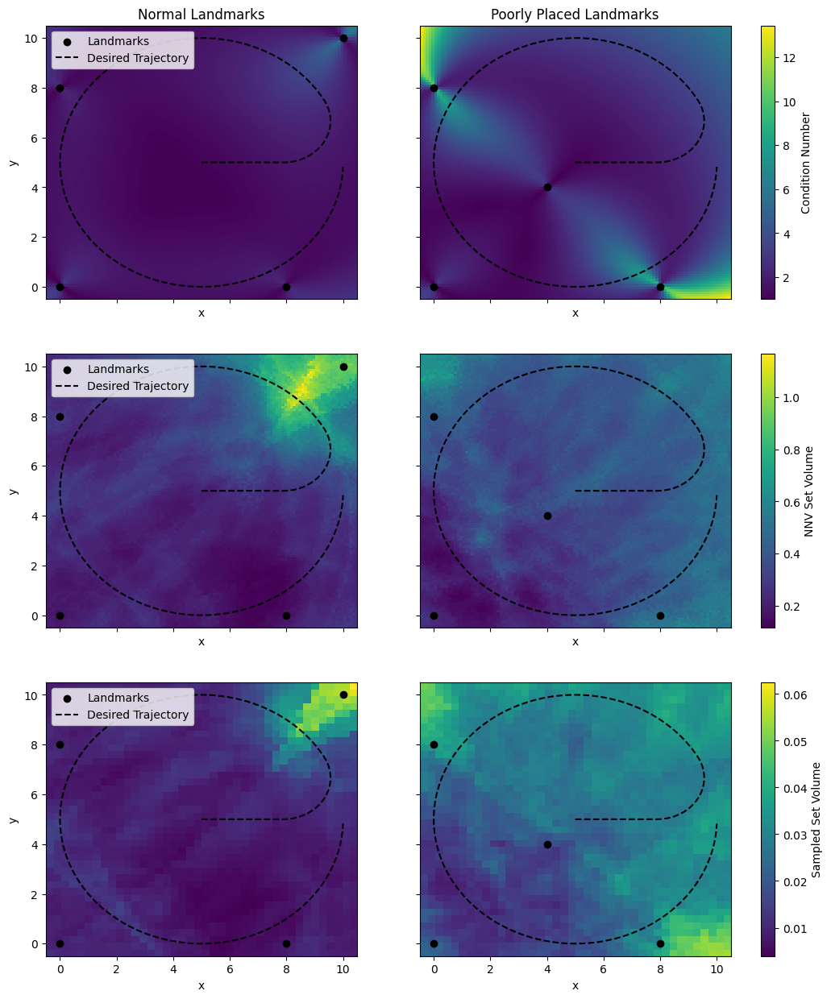

In [ ]:
# --- Shared plotting ---
fig, axes = plt.subplots(3, 2, figsize=(12, 15), sharex=True, sharey=True)

# Find global min/max for consistent scaling
vmin_sampled = min(np.nanmin(sampled_vals), np.nanmin(sampled_vals_worse))
vmax_sampled = max(np.nanmax(sampled_vals), np.nanmax(sampled_vals_worse))

# Plot 1
im1 = axes[0, 0].imshow(cond_vals, extent=[-0.5,10.5,-0.5,10.5],
                     origin='lower', aspect='auto', vmin=vmin, vmax=vmax)
axes[0, 0].scatter(landmarks[:,0], landmarks[:,1], c=landmark_color, marker='o', label="Landmarks")
axes[0, 0].plot(x_des_history, y_des_history, '--', color=des_color, label='Desired Trajectory')
axes[0, 0].set_title("Normal Landmarks")
axes[0, 0].set_xlabel("x")
axes[0, 0].set_ylabel("y")
axes[0, 0].set_xlim(-0.5, 10.5)
axes[0, 0].set_ylim(-0.5, 10.5)
axes[0, 0].legend(loc='upper left')

# Plot 2
im2 = axes[0, 1].imshow(cond_vals_worse, extent=[-0.5,10.5,-0.5,10.5],
                     origin='lower', aspect='auto', vmin=vmin, vmax=vmax)
axes[0, 1].scatter(landmarks_worse[:,0], landmarks_worse[:,1], c=landmark_color, marker='o', label="Landmarks")
axes[0, 1].plot(x_des_history, y_des_history, '--', color=des_color, label='Desired Trajectory')
axes[0, 1].set_title("Poorly Placed Landmarks")
axes[0, 1].set_xlabel("x")
axes[0, 1].set_xlim(-0.5, 10.5)
axes[0, 1].set_ylim(-0.5, 10.5)

# Plot 3
im3 = axes[1, 0].imshow(nnv_vals, extent=[-0.5,10.5,-0.5,10.5],
                     origin='lower', aspect='auto', vmin=vmin_nnv, vmax=vmax_nnv)
axes[1, 0].scatter(landmarks[:,0], landmarks[:,1], c=landmark_color, marker='o', label="Landmarks")
axes[1, 0].plot(x_des_history, y_des_history, '--', color=des_color, label='Desired Trajectory')
axes[1, 0].set_xlabel("x")
axes[1, 0].set_ylabel("y")
axes[1, 0].set_xlim(-0.5, 10.5)
axes[1, 0].set_ylim(-0.5, 10.5)
axes[1, 0].legend(loc='upper left')

# Plot 4
im4 = axes[1, 1].imshow(nnv_vals_worse, extent=[-0.5,10.5,-0.5,10.5],
                     origin='lower', aspect='auto', vmin=vmin_nnv, vmax=vmax_nnv)
axes[1, 1].scatter(landmarks_worse[:,0], landmarks_worse[:,1], c=landmark_color, marker='o', label="Landmarks")
axes[1, 1].plot(x_des_history, y_des_history, '--', color=des_color, label='Desired Trajectory')
axes[1, 1].set_xlabel("x")
axes[1, 1].set_xlim(-0.5, 10.5)
axes[1, 1].set_ylim(-0.5, 10.5)

# Plot 5
im5 = axes[2, 0].imshow(sampled_vals, extent=[-0.5,10.5,-0.5,10.5],
                     origin='lower', aspect='auto', vmin=vmin_sampled, vmax=vmax_sampled)
axes[2, 0].scatter(landmarks[:,0], landmarks[:,1], c=landmark_color, marker='o', label="Landmarks")
axes[2, 0].plot(x_des_history, y_des_history, '--', color=des_color, label='Desired Trajectory')
axes[2, 0].set_xlabel("x")
axes[2, 0].set_ylabel("y")
axes[2, 0].set_xlim(-0.5, 10.5)
axes[2, 0].set_ylim(-0.5, 10.5)
axes[2, 0].legend(loc='upper left')

# Plot 6
im6 = axes[2, 1].imshow(sampled_vals_worse, extent=[-0.5,10.5,-0.5,10.5],
                     origin='lower', aspect='auto', vmin=vmin_sampled, vmax=vmax_sampled)
axes[2, 1].scatter(landmarks_worse[:,0], landmarks_worse[:,1], c=landmark_color, marker='o', label="Landmarks")
axes[2, 1].plot(x_des_history, y_des_history, '--', color=des_color, label='Desired Trajectory')
axes[2, 1].set_xlabel("x")
axes[2, 1].set_xlim(-0.5, 10.5)
axes[2, 1].set_ylim(-0.5, 10.5)

# Shared colorbar for top row (axes[0, :])
cbar_top = fig.colorbar(im1, ax=axes[0, :], orientation='vertical', fraction=0.046, pad=0.04)
cbar_top.set_label("Condition Number")

# Shared colorbar for bottom row (axes[1, :])
cbar_bottom = fig.colorbar(im3, ax=axes[1, :], orientation='vertical', fraction=0.046, pad=0.04)
cbar_bottom.set_label("NNV Set Volume")

# Shared colorbar for bottom row (axes[2, :])
cbar_bottom = fig.colorbar(im6, ax=axes[2, :], orientation='vertical', fraction=0.046, pad=0.04)
cbar_bottom.set_label("Sampled Set Volume")

# plt.tight_layout()
plt.show()

In [ ]:
# --- Plot ---
plt.figure(figsize=(6,5))
plt.imshow(nnv_vals_worse, extent=[-0.5,10.5,-0.5,10.5], origin='lower', aspect='auto')
plt.colorbar(label="Condition Number")
plt.scatter(landmarks_worse[:,0], landmarks_worse[:,1], c='black', marker='o', label='Landmarks')
plt.xlabel("x")
plt.ylabel("y")
plt.legend()
plt.title("Condition number of FIM over grid [0,10]x[0,10]")
plt.show()

NameError: name 'plt' is not defined

In [ ]:
epsilon = 0.004
smoothing = True
smoothing_alpha = 0.5
dt = 0.1
max_input = 3.0
max_position_disturbance = 0.1
max_vel_disturbance = 0.01
seed = 0
model_name="image_estimator_16x128"
# model_name="image_estimator_16x128_2step-skip"
# model_name="image_estimator_16x224_2step-skip_5beacons_additive"
# model_name="simple_estimator_3t_long_range"

image_dynamics = BeaconDynamics(
    dt=dt,
    max_input=max_input,
    max_position_disturbance=max_position_disturbance,
    max_vel_disturbance=max_vel_disturbance,
    range_disturbance=epsilon*0.0001,
    obs_type="images",
    model_name=model_name,
    random_seed=seed
)
grid = hj.Grid.from_lattice_parameters_and_boundary_conditions(
            hj.sets.Box(
                np.array([-5., -5., -5., -5.]),
                np.array([15., 15., 5., 5.])),
            (30, 30, 20, 20),
        )
values_ = jnp.stack([jnp.abs(grid.states[..., 0] - 5.), jnp.abs(grid.states[..., 1] - 5.)], axis=-1)
values = -jnp.max(values_, axis=-1) + 5.

solver_settings = hj.SolverSettings.with_accuracy("very_high",
                                                  hamiltonian_postprocessor=hj.solver.backwards_reachable_tube)
cmap = 'viridis'

if smoothing:
    estimation_function = functools.partial(image_dynamics.get_smoothed_state_image_estimate, alpha=smoothing_alpha)
else:
    estimation_function = image_dynamics.get_state_estimate

hjnnv_filter = hjnnvUncertaintyAwareFilter(
    dynamics=image_dynamics,
    pred_model=estimation_function,
    grid=grid,
    initial_values=values,
    num_controls=30,
    num_disturbances=2
)

Loading CNN with input shape: (2, 16, 128)


ValueError: conv_general_dilated lhs feature dimension size divided by feature_group_count must equal the rhs input feature dimension size, but 3 // 1 != 2.

In [ ]:
from matplotlib import animation
from IPython.display import HTML

# Use x_des_history and y_des_history for the trajectory
num_steps_traj = len(x_des_history)

fig, ax = plt.subplots(figsize=(10,5))
im = ax.imshow(np.zeros((image_dynamics.image_size[0], image_dynamics.image_size[1])), cmap='gray', vmin=0, vmax=1)
ax.set_title("Panoramic Landmark View")

def update(frame_idx):
    x = jnp.array([x_des_history[frame_idx], y_des_history[frame_idx], 0.0, 0.0])
    image = image_dynamics.get_observation(x, time=0)
    im.set_data(image[:,:, 0, 1])
    ax.set_xlabel(f"x = ({x_des_history[frame_idx]:.2f}, {y_des_history[frame_idx]:.2f})")
    ax.set_aspect('equal')
    return [im]

ani = animation.FuncAnimation(fig, update, frames=num_steps_traj, interval=60, blit=True)
plt.close(fig)
HTML(ani.to_jshtml())

In [ ]:
from matplotlib import animation
from IPython.display import HTML

num_steps_traj = len(x_des_history)

fig, (ax_img, ax_traj) = plt.subplots(2, 1, figsize=(14, 6))

# Panoramic landmark view
im = ax_img.imshow(np.zeros((image_dynamics.image_size[1], image_dynamics.image_size[0])), cmap='gray', vmin=0, vmax=1)
ax_img.set_title("Panoramic Landmark View")

# Trajectory plot
ax_traj.plot(x_des_history, y_des_history, '--', color='gray', label='Desired Trajectory')
ax_traj.set_xlim(-1, 11)
ax_traj.set_ylim(-1, 11)
ax_traj.set_xlabel("x position")
ax_traj.set_ylabel("y position")
ax_traj.set_title("Current Position on Desired Path")
current_point, = ax_traj.plot([], [], 'ro', markersize=8, label='Current Position')
ax_traj.legend()

def update(frame_idx):
    # Update image
    x = jnp.array([x_des_history[frame_idx], y_des_history[frame_idx], 0.0, 0.0])
    image = image_dynamics.get_observation(x, time=0)
    im.set_data(image[:,:,0])
    ax_img.set_xlabel(f"x = ({x_des_history[frame_idx]:.2f}, {y_des_history[frame_idx]:.2f})")
    ax_img.set_aspect('equal')
    # Update trajectory point
    current_point.set_data([x_des_history[frame_idx]], [y_des_history[frame_idx]])
    return [im, current_point]

ani = animation.FuncAnimation(fig, update, frames=num_steps_traj, interval=60, blit=True)
plt.close(fig)
HTML(ani.to_jshtml())

Animation size has reached 20998056 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [ ]:
sample_type = "observations"
filter_type = "hjnnv_bestu" # "hjnnv_bestu" "hjnnv_maxval", "hj", "none"
traj_type = "spiral"

state_history = []
state_hat_history = []
state_bounds_history = []
state_sample_history = []
state_des_history = []

key = jax.random.PRNGKey(seed)
num_samples = 5000
image_dynamics.set_random_seed(seed)

if traj_type == "lawnmower":
    state = jnp.array([0.5, 0.5, 0.0, 0.0])  # initial state
    num_steps = 1650
elif traj_type == "spiral":
    state = jnp.array([5., 5., 0.0, 0.0])
    # num_steps = 650
    # num_steps = 700
    num_steps = 375
elif traj_type == "circle":
    state = jnp.array([8., 5., 0.0, 0.0])
    num_steps = 650
else:
    state = jnp.array([5.0, 5.0, 0.0, 0.0])  # initial state
    num_steps = 650

desired_traj = DesiredTrajectory(traj_type)
state_hat = state
u = rov_controller(state_hat, desired_traj, 0, kp=1.0, kd=0.1)

for step in range(num_steps):
    key, subkey = jax.random.split(key)
    t = step * image_dynamics.dt
    # Simulate the system dynamics
    if smoothing:
        obs = image_dynamics.get_observation(state, time=step)
        obs = obs.squeeze(axis=2)
        dyn_terms = jnp.zeros((obs.shape[0], obs.shape[1], 1))  # (batch, features, state(4) + input(2))
        dyn_terms = dyn_terms.at[0, 0:4, 0].set(state_hat)
        dyn_terms = dyn_terms.at[1, 0:2, 0].set(u)
        est_obs = jnp.concatenate([dyn_terms, obs], axis=2)
        print(est_obs.shape)
        state_hat = image_dynamics.get_smoothed_state_image_estimate(est_obs, smoothing_alpha).flatten()
    else:
        obs = image_dynamics.get_observation(state, time=step)
        obs = obs.squeeze(axis=2)
        state_hat = image_dynamics.get_state_estimate(obs).flatten()

    u_nominal = rov_controller(state_hat, desired_traj, t)

    time_start = time.time()
    if filter_type == "hjnnv_maxval" or filter_type == "hjnnv_bestu":
        if smoothing:
            bound_epsilon = jnp.concatenate([1e-8*jnp.ones((obs.shape[0], obs.shape[1], 1)), epsilon*jnp.ones((obs.shape[0], obs.shape[1], 2))], axis=2)
            state_bounds = hjnnv_filter.nnv_state_bounds(
                obs=est_obs,
                eps=bound_epsilon
            )
        else:
            state_bounds = hjnnv_filter.nnv_state_bounds(
                obs=obs,
                eps=epsilon
            )
        
        pos_buffer = 1.5e-1
        vel_buffer = 4e-1

        state_bounds = hj.sets.Box(
            lo=state_bounds.lo - jnp.array([pos_buffer, pos_buffer, vel_buffer, vel_buffer]),
            hi=state_bounds.hi + jnp.array([pos_buffer, pos_buffer, vel_buffer, vel_buffer])
        )

        if filter_type == "hjnnv_maxval":
            v_star, u_star, worst_val, val_filter, min_vals, distances = hjnnv_filter.ua_filter_max_val(
                u_nominal,
                state_bounds,
                num_states=2,
                eps=1e-6
            )
        elif filter_type == "hjnnv_bestu":
            v_star, u_star, worst_val, val_filter, min_vals, distances, _, _, = hjnnv_filter.ua_filter_best_u(
                u_nominal,
                state_bounds,
                num_states=2,
                delta=0.01
            )
    elif filter_type == "hj":
        obs_perturbations = jax.random.uniform(
            subkey, shape=(num_samples, obs.shape[0]),
            minval=-epsilon, maxval=epsilon
        )
        obs_samples = obs + obs_perturbations
        state_samples_0 = jax.vmap(lambda o: image_dynamics.get_state_estimate(o).flatten())(obs_samples)
        # With probability 0.5, pick the state sample furthest from (5,5,0,0), otherwise leave unchanged
        if jax.random.uniform(subkey) < 0.8:
            ref_point = jnp.array([5., 5., 0., 0.])
            distances = jnp.linalg.norm(state_samples_0 - ref_point, axis=1)
            furthest_idx = jnp.argmin(distances)
            state_hat = state_samples_0[furthest_idx]
        
        lo = state_hat - 1e-8
        hi = state_hat + 1e-8
        state_bounds = hj.sets.Box(
            lo,
            hi
        )
        time_start = time.time()
        v_star, u_star, worst_val, val_filter, min_vals, distances = hjnnv_filter.ua_filter_max_val(
            u_nominal,
            state_bounds,
            num_states=2
        )
    elif filter_type == "none":
        state_bounds = hj.sets.Box(
            state_hat - 1e-8,
            state_hat + 1e-8
        )
        v_star = None
        u_star = None
        worst_val = None
        val_filter = None
        min_vals = None
        distances = None

    if filter_type != 'none' and val_filter < 0.0:
        u = u_star
        # print(f"Step {step}: Using filtered control u_star={u}, val_filter={val_filter}")
        # mask = min_vals >= (v_star - 1e-7)  # candidates within tolerance
        # print(f"Step {step}: min_vals_masked={jnp.where(mask, distances, jnp.inf)}")
        # best_idx = jnp.argmin(jnp.where(mask, distances, jnp.inf))
        # print(f"Step {step}: best_idx={best_idx}, u_best={hjnnv_filter.control_vals[best_idx]}, v_best={min_vals[best_idx]}, dist_best={distances[best_idx]}")
        # print(f"Step {step}: Max min_vals={max(min_vals)}")
    else:
        u = u_nominal
    time_end = time.time()

    # obs_perturbations = jax.random.uniform(
    #     subkey, shape=(num_samples, obs.shape[0]),
    #     minval=-epsilon, maxval=epsilon
    # )
    # obs_samples = obs + obs_perturbations

    # if sample_type == "observations":
    #     state_samples_0 = jax.vmap(lambda o: image_dynamics.get_state_estimate(o).flatten())(obs_samples)
    # elif sample_type == "state_bounds":
    #     state_samples_0 = jax.random.uniform(
    #         subkey, shape=(num_samples, state.shape[0]),
    #         minval=state_bounds.lo, maxval=state_bounds.hi
    #     )

    # disturbances = jax.vmap(lambda k: image_dynamics.get_random_disturbance())(
    #     jax.random.split(subkey, num_samples)
    # )

    # state_samples = jax.vmap(
    #     lambda s, d: image_dynamics.step(s, u_nominal, d, time=step)
    # )(state_samples_0, disturbances)

    # state_sample_history.append(state_samples)

    # print(f"Step {step}: State: {state}")
    # print(f"Step {step}: Estimated State: {state_hat}")

    # print(f"Step {step}: best_val={v_star}")
    # print(f"Step {step}: state_bounds={state_bounds}")
    print(f"Step {step}: Filter execution time: {time_end - time_start:.5f} seconds")
    # if step > 194:
    #     print(f"Step {step}: min_vals={min_vals}")

    # Store the state
    # if step == 0:
    state_history.append(state)
    state_hat_history.append(state_hat)
    state_bounds_history.append(state_bounds)
    spline_x, spline_y = desired_traj.generate_trajectory()
    state_des_history.append(jnp.array([spline_x(t, 0), spline_y(t, 0), spline_x(t, 1), spline_y(t, 1)]))

    state = image_dynamics.step(state, u, image_dynamics.get_random_disturbance(), time=step)

(16, 128, 3)
Step 0: Filter execution time: 0.32882 seconds
(16, 128, 3)
Step 1: Filter execution time: 0.23599 seconds
(16, 128, 3)
Step 2: Filter execution time: 0.26722 seconds
(16, 128, 3)
Step 3: Filter execution time: 0.31132 seconds
(16, 128, 3)
Step 4: Filter execution time: 0.25568 seconds
(16, 128, 3)
Step 5: Filter execution time: 0.28788 seconds
(16, 128, 3)
Step 6: Filter execution time: 0.25672 seconds
(16, 128, 3)
Step 7: Filter execution time: 0.24118 seconds
(16, 128, 3)
Step 8: Filter execution time: 0.24058 seconds
(16, 128, 3)
Step 9: Filter execution time: 0.23710 seconds
(16, 128, 3)
Step 10: Filter execution time: 0.23583 seconds
(16, 128, 3)
Step 11: Filter execution time: 0.24518 seconds
(16, 128, 3)
Step 12: Filter execution time: 0.25346 seconds
(16, 128, 3)
Step 13: Filter execution time: 0.26201 seconds
(16, 128, 3)
Step 14: Filter execution time: 0.24632 seconds
(16, 128, 3)
Step 15: Filter execution time: 0.23979 seconds
(16, 128, 3)
Step 16: Filter execu

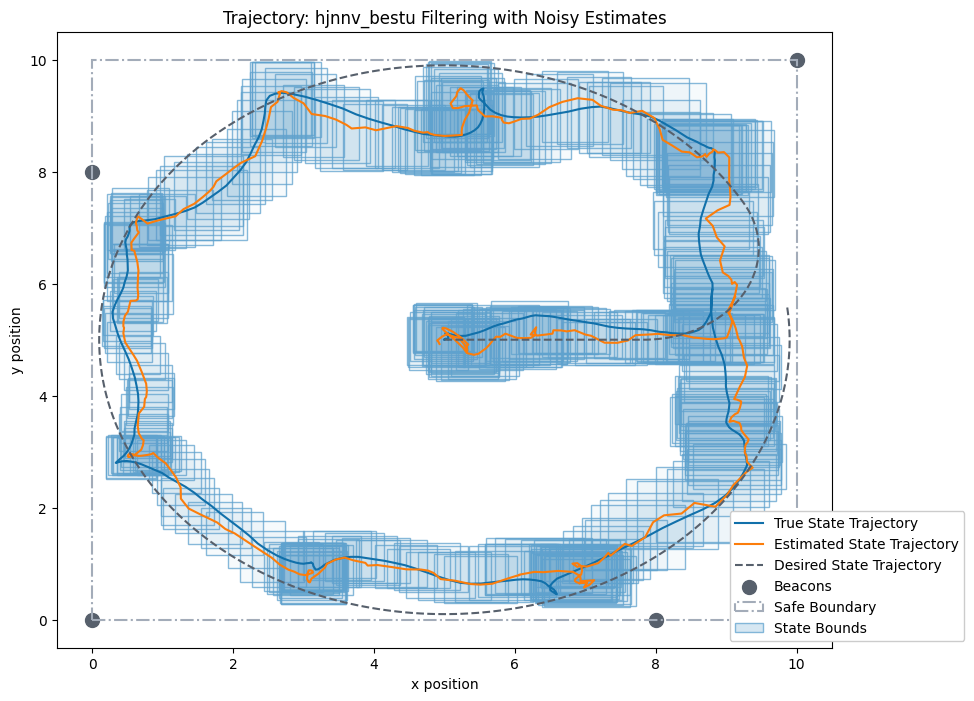

In [ ]:
import matplotlib.patches as patches

rgb_colors = np.array(pypalettes.load_cmap("Color_Blind").rgb)/255.0

darkblue = list(rgb_colors[0])
orange = list(rgb_colors[1])
med_grey = list(rgb_colors[2])
dark_grey = list(rgb_colors[3])
lightblue = list(rgb_colors[4])
red = list(rgb_colors[5])
darkmed_grey = list(rgb_colors[6])
lightlightblue = list(rgb_colors[7])


state_history = jnp.stack(state_history)
state_hat_history = jnp.stack(state_hat_history)

t_samples = np.linspace(0, num_steps * image_dynamics.dt, num_steps)
x_des_history = spline_x(t_samples, 0)
y_des_history = spline_y(t_samples, 0)



plt.figure(figsize=(10, 8))
plt.plot(state_history[:, 0], state_history[:, 1], label="True State Trajectory", c=darkblue)
plt.plot(state_hat_history[:, 0], state_hat_history[:, 1], label="Estimated State Trajectory", c=orange)
plt.plot(x_des_history, y_des_history, label="Desired State Trajectory", c=dark_grey, linestyle='--')
plt.scatter(image_dynamics.beacons[:, 0], image_dynamics.beacons[:, 1], color=dark_grey, marker='o', label="Beacons", s=100)


plt.gca().add_patch(patches.Rectangle((0, 0), 10, 10, linestyle='-.', linewidth=1.5, edgecolor=med_grey, facecolor='none', label="Safe Boundary"))

for i in range(len(state_bounds_history)):
    bounds = state_bounds_history[i]
    lo = bounds.lo
    hi = bounds.hi
    if i == len(state_bounds_history) - 1:
        rect = plt.Rectangle(
            (lo[0], lo[1]),
            hi[0] - lo[0],
            hi[1] - lo[1],
            linewidth=1,
            edgecolor=lightblue + [0.75],
            facecolor=lightblue + [0.25],
            label="State Bounds",
            zorder=0
        )
    else:
        rect = plt.Rectangle(
            (lo[0], lo[1]),
            hi[0] - lo[0],
            hi[1] - lo[1],
            linewidth=1,
            edgecolor=lightblue + [0.75],
            facecolor=lightblue + [0.05],
            zorder=0
        )
    plt.gca().add_patch(rect)
plt.xlabel("x position")
plt.ylabel("y position")
plt.title("Trajectory: {} Filtering with Noisy Estimates".format(filter_type))
plt.legend(loc="lower right", bbox_to_anchor=(1.18, 0.0), framealpha=1.0)
# plt.xlim(5.5, 5.8)
# plt.ylim(5.0, 5.3)
# plt.grid(True)
plt.show()

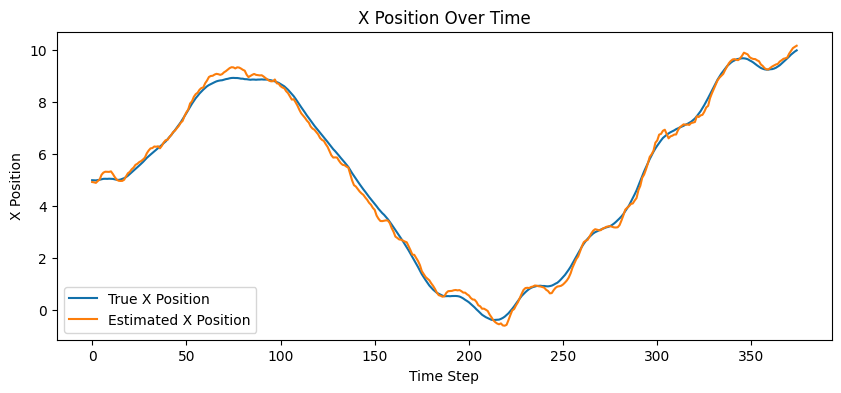

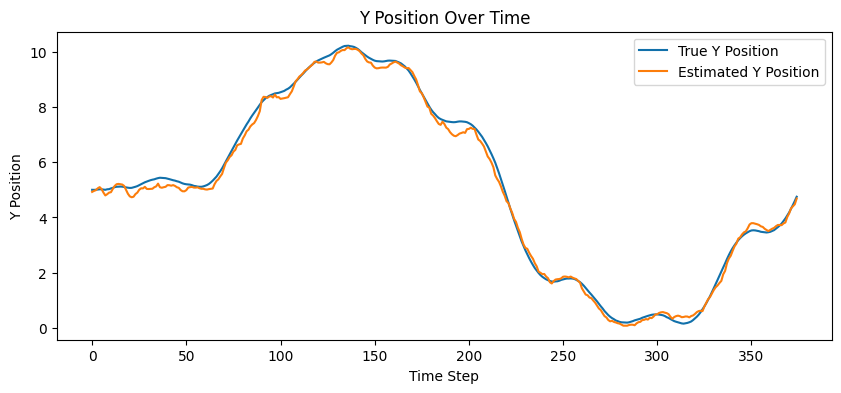

In [ ]:
plt.figure(figsize=(10, 4))
plt.plot(state_history[:, 0], label="True X Position", c=darkblue)
plt.plot(state_hat_history[:, 0], label="Estimated X Position", c=orange)
plt.xlabel("Time Step")
plt.ylabel("X Position")
plt.legend()
plt.title("X Position Over Time")
plt.show()

plt.figure(figsize=(10, 4))
plt.plot(state_history[:, 1], label="True Y Position", c=darkblue)
plt.plot(state_hat_history[:, 1], label="Estimated Y Position", c=orange)
plt.xlabel("Time Step")
plt.ylabel("Y Position")
plt.legend()
plt.title("Y Position Over Time")
plt.show()

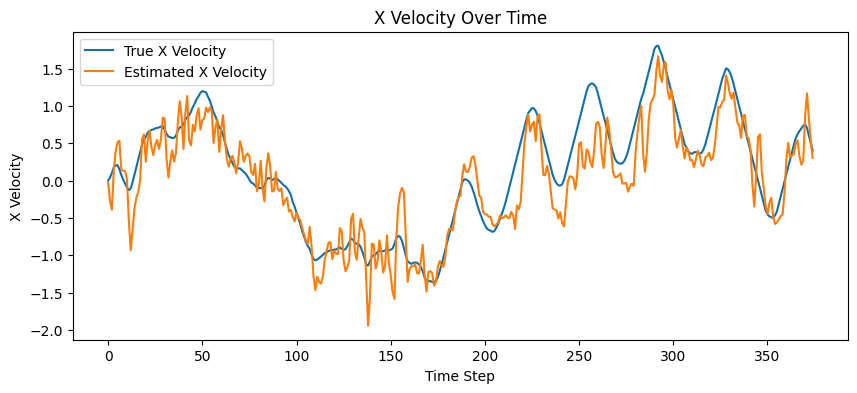

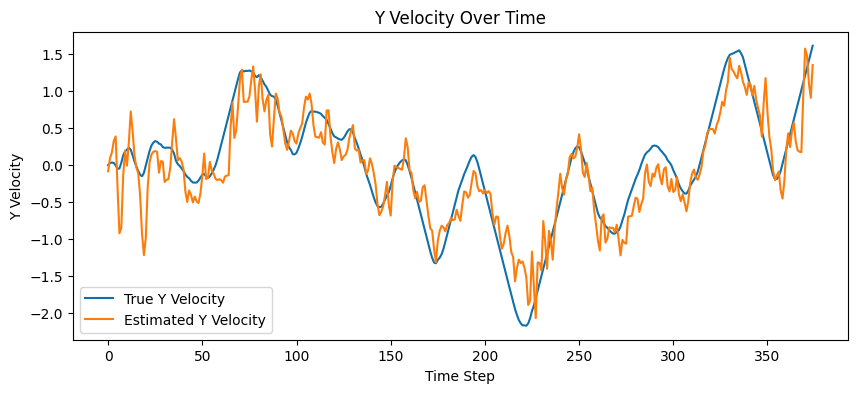

In [ ]:
plt.figure(figsize=(10, 4))
plt.plot(state_history[:, 2], label="True X Velocity", c=darkblue)
plt.plot(state_hat_history[:, 2], label="Estimated X Velocity", c=orange)
plt.xlabel("Time Step")
plt.ylabel("X Velocity")
plt.legend()
plt.title("X Velocity Over Time")
plt.show()

plt.figure(figsize=(10, 4))
plt.plot(state_history[:, 3], label="True Y Velocity", c=darkblue)
plt.plot(state_hat_history[:, 3], label="Estimated Y Velocity", c=orange)
plt.xlabel("Time Step")
plt.ylabel("Y Velocity")
plt.legend()
plt.title("Y Velocity Over Time")
plt.show()